---

### Author: 

    Habiba Mowafy

---

## Cellula Internship - Task 5

### Uber Modeling

---

This notebook is part of the Cellula Internship program. The objective of this task is to analyze a dataset related to Uber rides, build predictive models, evaluate their performance, and derive insights from the modeling results.

---

In [2]:
#Importing the necessary libraries
# Standard library imports
import re
import time
from datetime import datetime

# Data manipulation and analysis
import numpy as np
import pandas as pd

# Visualization libraries
import matplotlib.pyplot as plt
import matplotlib.colors as colors
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns

# Statistical analysis
import scipy.stats as stats
from statsmodels.stats.outliers_influence import variance_inflation_factor

# Machine learning libraries
from sklearn.ensemble import RandomForestRegressor
from sklearn.impute import SimpleImputer
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

# Mapping and visualization tools
import folium
from folium.plugins import HeatMap

# Other utilities
import holidays
import joblib

In [3]:
data = pd.read_csv('final_internship_data.csv')

In [4]:
pd.set_option('display.max_columns', None)

In [5]:
data.head()

,User ID,User Name,Driver Name,Car Condition,Weather,Traffic Condition,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,hour,day,month,weekday,year,jfk_dist,ewr_dist,lga_dist,sol_dist,nyc_dist,distance,bearing
0,KHVrEVlD,Kimberly Adams,Amy Butler,Very Good,windy,Congested Traffic,2009-06-15 17:26:21.0000001,4.5,2009-06-15 17:26:21,-1.288826,0.710721,-1.288779,0.710563,1,17,15,6,0,2009,20.265840,55.176046,14.342611,34.543548,27.572573,1.030764,-2.918897
1,lPxIuEri,Justin Tapia,Hannah Zimmerman,Excellent,cloudy,Flow Traffic,2010-01-05 16:52:16.0000002,16.9,2010-01-05 16:52:16,-1.291824,0.710546,-1.291182,0.711780,1,16,5,1,1,2010,44.667679,31.832358,23.130775,15.125872,8.755732,8.450134,-0.375217
2,gsVN8JLS,Elizabeth Lopez,Amanda Jackson,Bad,stormy,Congested Traffic,2011-08-18 00:35:00.00000049,5.7,2011-08-18 00:35:00,-1.291242,0.711418,-1.291391,0.711231,2,0,18,8,3,2011,43.597686,33.712082,19.865289,17.722624,9.847344,1.389525,2.599961
3,9I7kWFgd,Steven Wilson,Amy Horn,Very Good,stormy,Flow Traffic,2012-04-21 04:30:42.0000001,7.7,2012-04-21 04:30:42,-1.291319,0.710927,-1.291396,0.711363,1,4,21,4,5,2012,42.642965,32.556289,21.063132,15.738963,7.703421,2.799270,0.133905
4,8QN5ZaGN,Alexander Andrews,Cassandra Larson,Bad,stormy,Congested Traffic,2010-03-09 07:51:00.000000135,5.3,2010-03-09 07:51:00,-1.290987,0.711536,-1.290787,0.711811,1,7,9,3,1,2010,43.329953,39.406828,15.219339,23.732406,15.600745,1.999157,-0.502703


In [6]:
# Rename some columns
data.rename(columns={'key': 'Ride ID',
                    'hour': 'Request Hour',
                    'day': 'Request Day',
                    'month': 'Request Month',
                    'weekday': 'Request Day of the week',
                    'year': 'Request Year',
                    'jfk_dist': 'Distance from JFK Airport',
                    'ewr_dist': 'Distance from EWR Airport',
                    'lga_dist': 'Distance from LGA Airport',
                    'sol_dist': 'Distance from SOL',
                    'nyc_dist': 'Distance from NYC',
                    'distance': 'Ride Distance'},
            inplace=True, errors='raise')

In [7]:
data.iloc[:, :20].info()  # Display info for the first 20 columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500000 entries, 0 to 499999
Data columns (total 20 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   User ID                    500000 non-null  object 
 1   User Name                  500000 non-null  object 
 2   Driver Name                500000 non-null  object 
 3   Car Condition              500000 non-null  object 
 4   Weather                    500000 non-null  object 
 5   Traffic Condition          500000 non-null  object 
 6   Ride ID                    500000 non-null  object 
 7   fare_amount                500000 non-null  float64
 8   pickup_datetime            500000 non-null  object 
 9   pickup_longitude           500000 non-null  float64
 10  pickup_latitude            500000 non-null  float64
 11  dropoff_longitude          499995 non-null  float64
 12  dropoff_latitude           499995 non-null  float64
 13  passenger_count            50

In [8]:
data.iloc[:, -6:].info() # Display info for the last 6 columns

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 500000 entries, 0 to 499999
Data columns (total 6 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   Distance from EWR Airport  499995 non-null  float64
 1   Distance from LGA Airport  499995 non-null  float64
 2   Distance from SOL          499995 non-null  float64
 3   Distance from NYC          499995 non-null  float64
 4   Ride Distance              499995 non-null  float64
 5   bearing                    499995 non-null  float64
dtypes: float64(6)
memory usage: 22.9 MB


In [9]:
data.nunique()

User ID                      500000
User Name                    221675
Driver Name                  221700
Car Condition                     4
Weather                           5
Traffic Condition                 3
Ride ID                      500000
fare_amount                    1688
pickup_datetime              461206
pickup_longitude              95037
pickup_latitude              119115
dropoff_longitude            108283
dropoff_latitude             135053
passenger_count                   7
Request Hour                     24
Request Day                      31
Request Month                    12
Request Day of the week           7
Request Year                      7
Distance from JFK Airport    490613
Distance from EWR Airport    490613
Distance from LGA Airport    490613
Distance from SOL            490613
Distance from NYC            490613
Ride Distance                485705
bearing                      485636
dtype: int64

In [10]:
# Discover the unique values of the columns
checked_columns = ['Car Condition', 'Weather', 'Traffic Condition']
for column in checked_columns:
    print(column)
    print(data[column].unique())
    print("----------------")

Car Condition
['Very Good' 'Excellent' 'Bad' 'Good']
----------------
Weather
['windy' 'cloudy' 'stormy' 'sunny' 'rainy']
----------------
Traffic Condition
['Congested Traffic' 'Flow Traffic' 'Dense Traffic']
----------------


In [11]:
data.describe()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Request Hour,Request Day,Request Month,Request Day of the week,Request Year,Distance from JFK Airport,Distance from EWR Airport,Distance from LGA Airport,Distance from SOL,Distance from NYC,Ride Distance,bearing
count,500000.000000,500000.000000,500000.000000,499995.000000,499995.000000,500000.000000,500000.000000,500000.000000,500000.000000,500000.000000,500000.000000,499995.000000,499995.000000,499995.000000,499995.000000,499995.000000,499995.000000,499995.000000
mean,11.358361,-1.265712,0.696740,-1.265755,0.696675,1.683428,13.510834,15.684206,6.268650,3.042008,2011.739132,385.279367,380.503657,363.843772,363.674038,355.991423,19.468775,0.297145
std,9.916617,0.206941,0.140909,0.205903,0.128997,1.307395,6.511571,8.681066,3.437815,1.949240,1.860889,2419.087483,2428.804740,2425.075903,2428.348683,2428.730839,367.299601,1.804548
min,-44.900000,-52.119764,-54.389440,-59.049665,-44.676047,0.000000,0.000000,1.000000,1.000000,0.000000,2009.000000,1.017646,1.460945,0.382119,0.532545,0.080500,0.000000,-3.141593
25%,6.000000,-1.291405,0.710958,-1.291393,0.710943,1.000000,9.000000,8.000000,3.000000,1.000000,2010.000000,41.341514,32.173712,17.100762,14.886989,7.147384,1.214550,-0.854721
50%,8.500000,-1.291226,0.711268,-1.291197,0.711277,1.000000,14.000000,16.000000,6.000000,3.000000,2012.000000,42.523163,34.787507,19.591554,18.347580,10.458151,2.116970,-0.050442
75%,12.500000,-1.290970,0.711520,-1.290908,0.711538,2.000000,19.000000,23.000000,9.000000,5.000000,2013.000000,43.785649,38.304502,22.214815,22.417812,14.448699,3.890070,2.206769
max,500.000000,37.360538,29.724576,0.712985,7.061893,6.000000,23.000000,31.000000,12.000000,6.000000,2015.000000,30133.067880,30167.595967,30167.285794,30159.407296,30162.285356,12399.956433,3.141593


---

### Handling Missing Values 

In [12]:
data.dropna(inplace=True)

In [13]:
print("\nRows with null values AFTER handling:")
null_rows_after = data[data.isnull().any(axis=1)]
print(null_rows_after if not null_rows_after.empty else "No rows with null values found")


Rows with null values AFTER handling:
No rows with null values found


In [14]:
data.isnull().sum()

User ID                      0
User Name                    0
Driver Name                  0
Car Condition                0
Weather                      0
Traffic Condition            0
Ride ID                      0
fare_amount                  0
pickup_datetime              0
pickup_longitude             0
pickup_latitude              0
dropoff_longitude            0
dropoff_latitude             0
passenger_count              0
Request Hour                 0
Request Day                  0
Request Month                0
Request Day of the week      0
Request Year                 0
Distance from JFK Airport    0
Distance from EWR Airport    0
Distance from LGA Airport    0
Distance from SOL            0
Distance from NYC            0
Ride Distance                0
bearing                      0
dtype: int64

### Checking datetime regex

In [15]:
def is_valid_datetime_format(date):
    if pd.isna(date):
        return False
    # Pattern for YYYY-MM-DD HH:MM:SS
    pattern = r'^\d{4}-\d{2}-\d{2} \d{2}:\d{2}:\d{2}$'
    return bool(re.match(pattern, str(date)))

In [16]:
# Apply the function to check invalid datetime formats
invalid_dates = data[~data['pickup_datetime'].apply(is_valid_datetime_format)]

print(f"Number of invalid dates: {len(invalid_dates)}")
if not invalid_dates.empty:
    print("\nExamples of invalid dates:")
    print(invalid_dates['pickup_datetime'].head())

Number of invalid dates: 0


### Checking for outliers

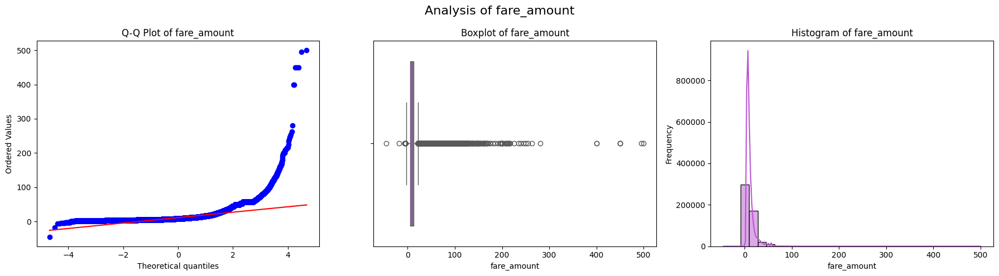

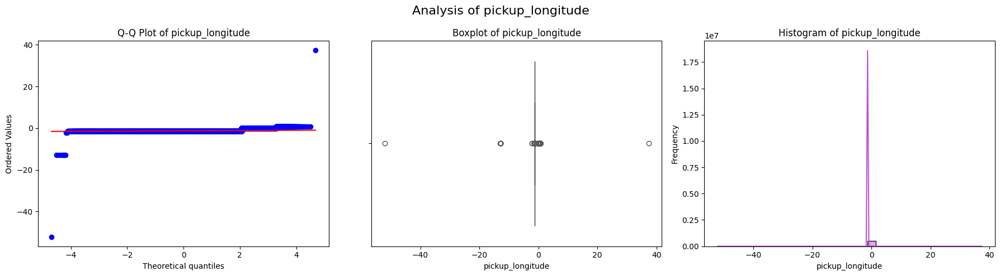

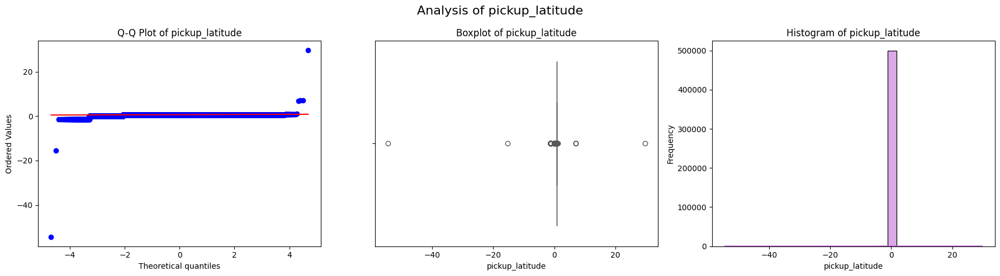

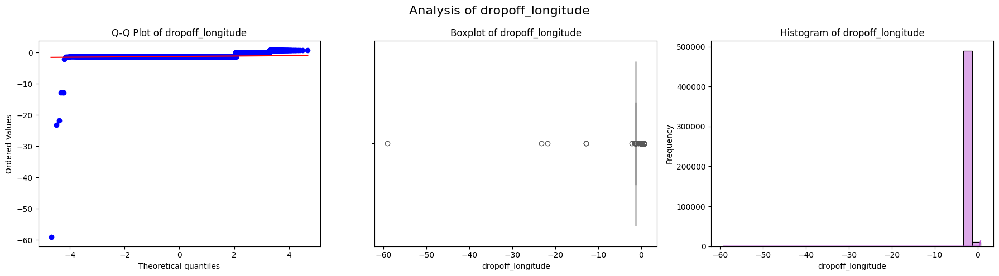

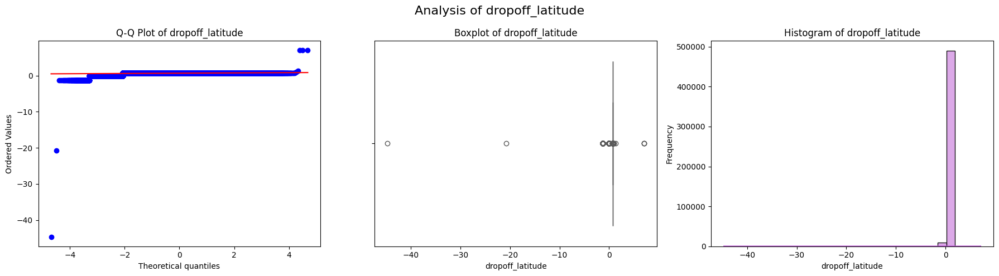

...

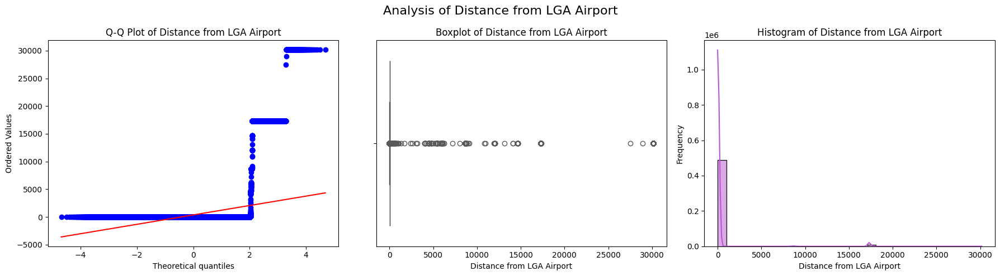

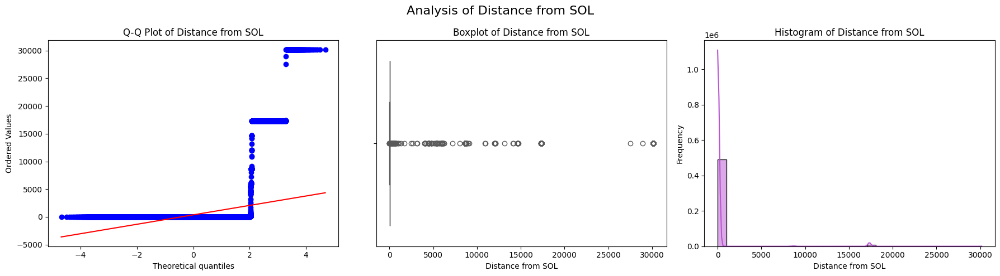

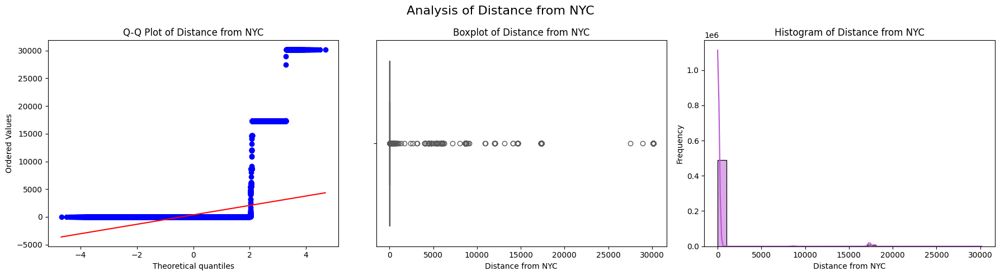

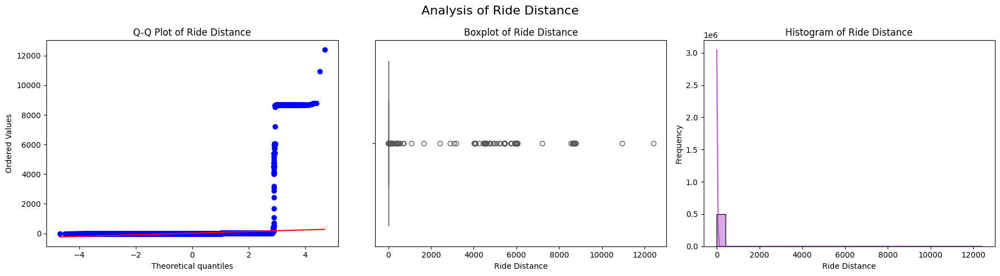

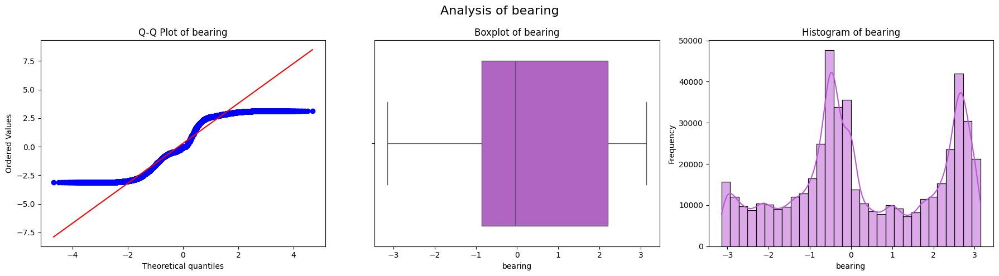

In [17]:
# Identify numerical columns from the dataset
numerical_features = data.select_dtypes(include=['int64', 'float64']).columns.tolist()

# Create a figure for each numerical feature with 3 plots
for feature in numerical_features:
    plt.figure(figsize=(18, 5))
    
    # First subplot: Q-Q Plot
    plt.subplot(1, 3, 1)
    stats.probplot(data[feature], dist="norm", plot=plt)
    plt.title(f'Q-Q Plot of {feature}')
    
    # Second subplot: Boxplot
    plt.subplot(1, 3, 2)
    sns.boxplot(x=data[feature], color='mediumorchid')
    plt.title(f'Boxplot of {feature}')
    plt.xlabel(feature)
    
    # Third subplot: Histogram
    plt.subplot(1, 3, 3)
    sns.histplot(data[feature], bins=30, kde=True, color='mediumorchid')
    plt.title(f'Histogram of {feature}')
    plt.xlabel(feature)
    plt.ylabel('Frequency')
    
    plt.suptitle(f'Analysis of {feature}', fontsize=16)
    plt.tight_layout()
    plt.show()

In [18]:
# Create a map centered at the mean of pickup coordinates
center_lat = data['pickup_latitude'].mean()
center_lon = data['pickup_longitude'].mean()
nyc_map = folium.Map(location=[center_lat, center_lon], zoom_start=11)

# Sample the data if it's too large (optional)
sample_size = min(10000, len(data))
sampled_data = data.sample(sample_size)

# Add pickup points to the map
for idx, row in sampled_data.iterrows():
    # Use bearing to determine color (normalize to 0-360 degrees)
    bearing_color = plt.cm.hsv(row['bearing'] / 360.0 if not np.isnan(row['bearing']) else 0)
    hex_color = colors.rgb2hex(bearing_color)
    
    # Add pickup marker with color based on bearing
    folium.CircleMarker(
        location=[row['pickup_latitude'], row['pickup_longitude']],
        radius=2,
        color=hex_color,
        fill=True,
        fill_color=hex_color,
        fill_opacity=0.7,
        popup=f"Bearing: {row['bearing']:.1f}°, Fare: ${row['fare_amount']:.2f}"
    ).add_to(nyc_map)

# Add a heatmap of pickup locations
heat_data = [[row['pickup_latitude'], row['pickup_longitude']] for idx, row in sampled_data.iterrows()]
HeatMap(heat_data, radius=15).add_to(nyc_map)

# Display the map
nyc_map

In [19]:
# Create a map centered at the mean of dropoff coordinates
center_lat = data['dropoff_latitude'].mean()
center_lon = data['dropoff_longitude'].mean()
dropoff_map = folium.Map(location=[center_lat, center_lon], zoom_start=11)

# Sample the data if it's too large (optional)
sample_size = min(10000, len(data))
sampled_data = data.sample(sample_size)

# Add dropoff points to the map
for idx, row in sampled_data.iterrows():
    # Use bearing to determine color (normalize to 0-360 degrees)
    bearing_color = plt.cm.hsv(row['bearing'] / 360.0 if not np.isnan(row['bearing']) else 0)
    hex_color = colors.rgb2hex(bearing_color)
    
    # Add dropoff marker with color based on bearing
    folium.CircleMarker(
        location=[row['dropoff_latitude'], row['dropoff_longitude']],
        radius=2,
        color=hex_color,
        fill=True,
        fill_color=hex_color,
        fill_opacity=0.7,
        popup=f"Bearing: {row['bearing']:.1f}°, Fare: ${row['fare_amount']:.2f}"
    ).add_to(dropoff_map)

# Add a heatmap of dropoff locations
heat_data = [[row['dropoff_latitude'], row['dropoff_longitude']] for idx, row in sampled_data.iterrows()]
HeatMap(heat_data, radius=15).add_to(dropoff_map)

# Display the map
dropoff_map

In [20]:
data.drop(['pickup_longitude', 'pickup_latitude', 'dropoff_longitude', 'dropoff_latitude'], axis=1, inplace=True)

In [21]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 499995 entries, 0 to 499999
Data columns (total 22 columns):
 #   Column                     Non-Null Count   Dtype  
---  ------                     --------------   -----  
 0   User ID                    499995 non-null  object 
 1   User Name                  499995 non-null  object 
 2   Driver Name                499995 non-null  object 
 3   Car Condition              499995 non-null  object 
 4   Weather                    499995 non-null  object 
 5   Traffic Condition          499995 non-null  object 
 6   Ride ID                    499995 non-null  object 
 7   fare_amount                499995 non-null  float64
 8   pickup_datetime            499995 non-null  object 
 9   passenger_count            499995 non-null  int64  
 10  Request Hour               499995 non-null  int64  
 11  Request Day                499995 non-null  int64  
 12  Request Month              499995 non-null  int64  
 13  Request Day of the week    499995 

In [22]:
# For later comparison
data_original = data.copy()

### Handling Distance Columns Outliers

In [23]:
distance_columns = [
    'Ride Distance',
    'Distance from JFK Airport',
    'Distance from EWR Airport',
    'Distance from LGA Airport',
    'Distance from SOL',
    'Distance from NYC'
]

In [24]:
def clean_distance_column(df, column_name):
    print(f"\nCleaning {column_name}:")
    
    # First, examine the distribution
    print(f"Original stats:")
    print(f"Min: {df[column_name].min():.2f}, Max: {df[column_name].max():.2f}")
    print(f"Mean: {df[column_name].mean():.2f}, Median: {df[column_name].median():.2f}")

    # Different max distances for different reference points
    if 'Ride Distance' in column_name:
        min_distance = 0.1  # miles
        max_distance = 100  # miles for actual ride distance
    elif 'JFK' in column_name or 'EWR' in column_name or 'LGA' in column_name:
        min_distance = 0   # Can be at the airport (0 distance)
        max_distance = 70  # miles from airport (covers entire NYC metro area)
    elif 'SOL' in column_name or 'NYC' in column_name:
        min_distance = 0   # Can be at these landmarks
        max_distance = 50  # miles from city center or Statue of Liberty
    else:
        min_distance = 0
        max_distance = 100  # Default values
    
    filtered_df = df[(df[column_name] >= min_distance) & (df[column_name] <= max_distance)]
    
    filtered_count = len(filtered_df)
    original_count = len(df)
    
    print(f"Removed {original_count - filtered_count} rows with distances outside [{min_distance}, {max_distance}] miles")
 
    Q1 = filtered_df[column_name].quantile(0.25)
    Q3 = filtered_df[column_name].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = max(Q1 - 1.5 * IQR, 0)  # Non-negative distance
    upper_bound = Q3 + 1.5 * IQR

    print(f"IQR bounds: {lower_bound:.2f} to {upper_bound:.2f} miles")
    outliers = filtered_df[(filtered_df[column_name] < lower_bound) | 
                          (filtered_df[column_name] > upper_bound)]
    print(f"Found {len(outliers)} statistical outliers")
    
    # Cap the distance values
    filtered_df[column_name] = filtered_df[column_name].clip(lower=lower_bound, upper=upper_bound)
    
    # Visualize the cleaned distribution
    plt.figure(figsize=(18, 5))
    plt.subplot(1, 3, 1)
    stats.probplot(filtered_df[column_name], dist="norm", plot=plt)
    plt.title(f'Q-Q Plot of {column_name}')
    plt.subplot(1, 3, 2)
    sns.histplot(filtered_df[column_name], bins=50, kde=True, color='mediumorchid')
    plt.title(f'Cleaned {column_name} Distribution')
    plt.subplot(1, 3, 3)
    sns.boxplot(y=filtered_df[column_name], color='mediumorchid')
    plt.title(f'Cleaned {column_name} Boxplot')
    plt.tight_layout()
    plt.show()
    
    print(f"Cleaned stats:")
    print(f"Min: {filtered_df[column_name].min():.2f}, Max: {filtered_df[column_name].max():.2f}")
    print(f"Mean: {filtered_df[column_name].mean():.2f}, Median: {filtered_df[column_name].median():.2f}")
    
    return filtered_df

In [25]:
data_cleaned = data.copy()


Cleaning Ride Distance:
Original stats:
Min: 0.00, Max: 12399.96
Mean: 19.47, Median: 2.12
Removed 18315 rows with distances outside [0.1, 100] miles
IQR bounds: 0.00 to 8.00 miles
Found 40080 statistical outliers


C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\955840944.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df[column_name] = filtered_df[column_name].clip(lower=lower_bound, upper=upper_bound)


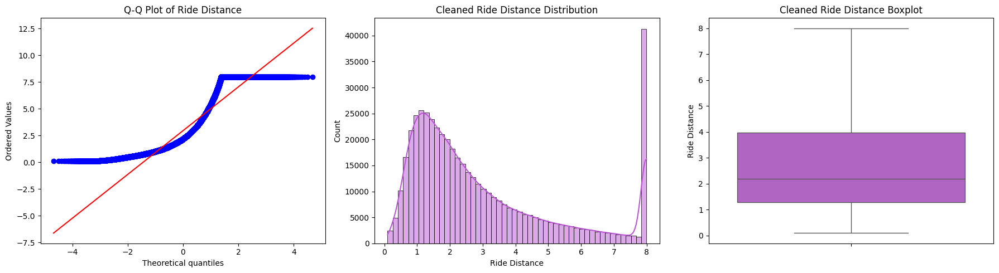

Cleaned stats:
Min: 0.10, Max: 8.00
Mean: 2.96, Median: 2.19
------------------------------

Cleaning Distance from JFK Airport:
Original stats:
Min: 1.02, Max: 30133.07
Mean: 58.74, Median: 42.48
Removed 559 rows with distances outside [0, 70] miles
IQR bounds: 37.79 to 47.20 miles
Found 49301 statistical outliers


C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\955840944.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df[column_name] = filtered_df[column_name].clip(lower=lower_bound, upper=upper_bound)


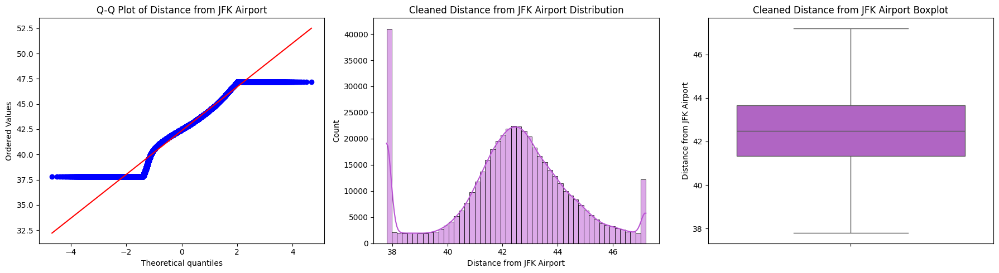

Cleaned stats:
Min: 37.79, Max: 47.20
Mean: 42.36, Median: 42.48
------------------------------

Cleaning Distance from EWR Airport:
Original stats:
Min: 1.69, Max: 127.00
Mean: 35.58, Median: 34.65
Removed 290 rows with distances outside [0, 70] miles
IQR bounds: 23.28 to 46.84 miles
Found 17863 statistical outliers


C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\955840944.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df[column_name] = filtered_df[column_name].clip(lower=lower_bound, upper=upper_bound)


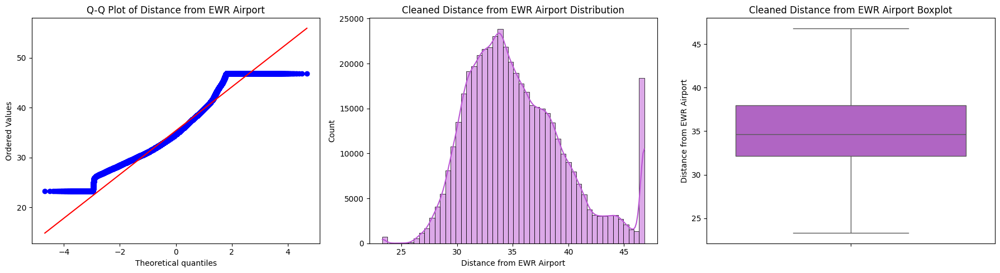

Cleaned stats:
Min: 23.28, Max: 46.84
Mean: 35.39, Median: 34.65
------------------------------

Cleaning Distance from LGA Airport:
Original stats:
Min: 0.38, Max: 72.67
Mean: 19.49, Median: 19.49
Removed 1 rows with distances outside [0, 70] miles
IQR bounds: 9.62 to 29.43 miles
Found 11737 statistical outliers


C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\955840944.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df[column_name] = filtered_df[column_name].clip(lower=lower_bound, upper=upper_bound)


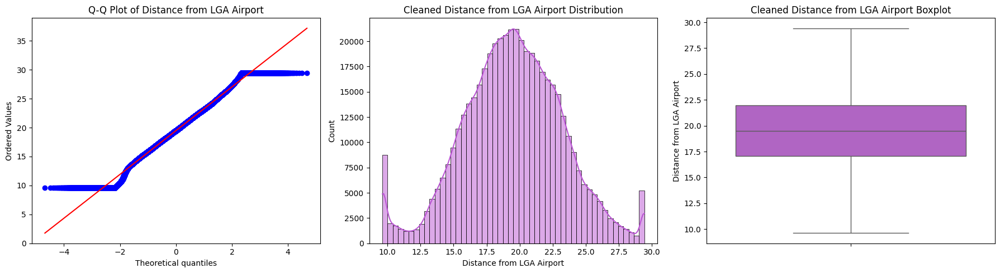

Cleaned stats:
Min: 9.62, Max: 29.43
Mean: 19.48, Median: 19.49
------------------------------

Cleaning Distance from SOL:
Original stats:
Min: 0.53, Max: 61.49
Mean: 18.78, Median: 18.18
Removed 63 rows with distances outside [0, 50] miles
IQR bounds: 3.88 to 33.00 miles
Found 7621 statistical outliers


C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\955840944.py:42: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df[column_name] = filtered_df[column_name].clip(lower=lower_bound, upper=upper_bound)


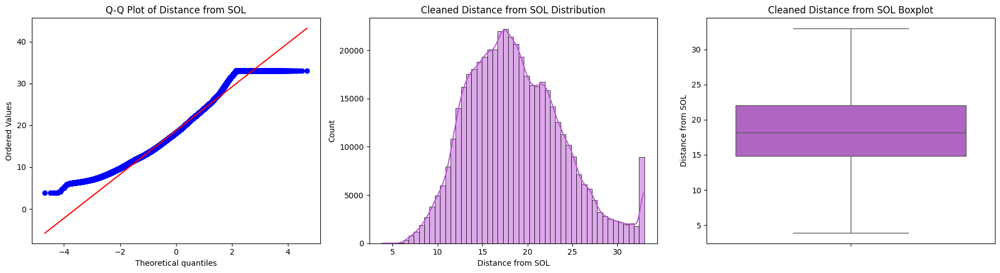

Cleaned stats:
Min: 3.88, Max: 33.00
Mean: 18.71, Median: 18.18
------------------------------

Cleaning Distance from NYC:
Original stats:
Min: 0.21, Max: 49.85
Mean: 11.03, Median: 10.30
Removed 0 rows with distances outside [0, 50] miles
IQR bounds: 0.00 to 24.69 miles
Found 11629 statistical outliers


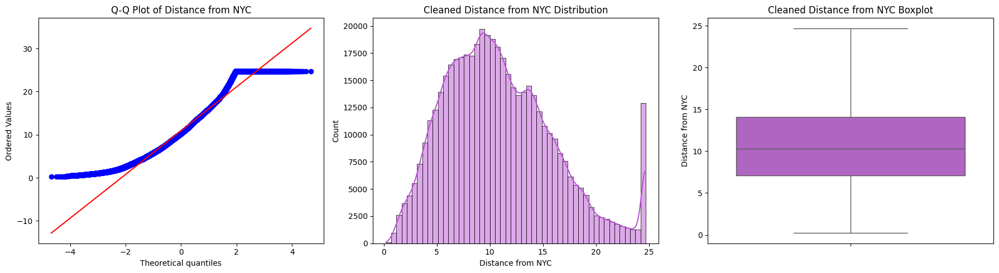

Cleaned stats:
Min: 0.21, Max: 24.69
Mean: 10.93, Median: 10.30
------------------------------

After cleaning all distance columns: 480767 records remaining


In [26]:
for column in distance_columns:
    data_cleaned = clean_distance_column(data_cleaned, column)
    print("-" * 30)

print(f"\nAfter cleaning all distance columns: {len(data_cleaned)} records remaining")

### Handling Fare Amount Outliers

In [27]:
fare_col = 'fare_amount'
ride_dist_col = 'Ride Distance'

In [28]:
# First, examine the fare distribution
print(f"Original fare stats:")
print(f"Min: ${data_cleaned[fare_col].min():.2f}, Max: ${data_cleaned[fare_col].max():.2f}")
print(f"Mean: ${data_cleaned[fare_col].mean():.2f}, Median: ${data_cleaned[fare_col].median():.2f}")

Original fare stats:
Min: $-18.10, Max: $450.00
Mean: $11.27, Median: $8.50


In [29]:
grouping_factors = ['Car Condition', 'Weather', 'Traffic Condition', 
                   'Request Day of the week', 'Request Hour']

# For each combination of factors, apply separate fare cleaning
cleaned_groups = []

In [30]:
# Car Condition multipliers - from worst to best
car_condition_multipliers = {
    'Bad': 2.0,       # Most variance allowed for bad cars
    'Good': 1.7,      # Some variance for good cars
    'Very Good': 1.5, # Less variance for very good cars
    'Excellent': 1.3  # Least variance for excellent cars
}
# Weather condition multipliers - from most to least severe
weather_condition_multipliers = {
    'stormy': 2.0,    # Most variance for stormy weather
    'rainy': 1.8,     # High variance for rainy weather
    'windy': 1.6,     # Medium-high variance for windy conditions
    'cloudy': 1.5,    # Medium variance for cloudy conditions
    'sunny': 1.3      # Least variance for sunny conditions
}

# Traffic condition multipliers - from worst to best
traffic_condition_multipliers = {
    'Congested Traffic': 2.0,  # Most variance for congested traffic
    'Dense Traffic': 1.8,      # Medium variance for dense traffic
    'Flow Traffic': 1.5        # Least variance for flowing traffic
}

In [31]:
for name, group in data_cleaned.groupby(grouping_factors): 
    # Calculate group-specific IQR bounds
    Q1 = group[fare_col].quantile(0.25)
    Q3 = group[fare_col].quantile(0.75)
    IQR = Q3 - Q1
    
    # Get conditions for this group
    weather_cond = group['Weather'].iloc[0]
    traffic_cond = group['Traffic Condition'].iloc[0]
    car_cond = group['Car Condition'].iloc[0]
    
    # Get multipliers for each condition
    car_multiplier = car_condition_multipliers.get(car_cond, 1.5)
    weather_multiplier = weather_condition_multipliers.get(weather_cond, 1.5)
    traffic_multiplier = traffic_condition_multipliers.get(traffic_cond, 1.5)
    
    # Take the maximum multiplier among the three conditions
    # This ensures we use the most permissive bound when any condition is severe
    max_multiplier = max(car_multiplier, weather_multiplier, traffic_multiplier)
    
    # Apply bounds with the determined multiplier
    lower_bound = max(Q1 - max_multiplier * IQR, 2.5)  # Minimum fare $2.50
    upper_bound = Q3 + max_multiplier * IQR
    
    # Cap the fares in this specific group
    group_cleaned = group.copy()
    group_cleaned[fare_col] = group_cleaned[fare_col].clip(lower=lower_bound, upper=upper_bound)
    cleaned_groups.append(group_cleaned)

In [32]:
# Combine all the cleaned groups
df_fare_cleaned = pd.concat(cleaned_groups)

print(f"Cleaned fare amounts using context-aware grouping")
print(f"Remaining data points: {len(df_fare_cleaned)}")

Cleaned fare amounts using context-aware grouping
Remaining data points: 480767


In [33]:
# Check the fare-distance relationship
df_fare_cleaned['fare_per_mile'] = df_fare_cleaned[fare_col] / df_fare_cleaned[ride_dist_col]

In [34]:
# Different thresholds for short vs long rides
short_rides = df_fare_cleaned[ride_dist_col] < 2.0
max_fare_per_mile_short = 25.0  # Higher threshold for short rides
max_fare_per_mile_regular = 10.0  # Lower threshold for regular rides

relationship_filtered = df_fare_cleaned[
    (short_rides & (df_fare_cleaned['fare_per_mile'] <= max_fare_per_mile_short)) |
    (~short_rides & (df_fare_cleaned['fare_per_mile'] <= max_fare_per_mile_regular))
]

print(f"\nFare-distance relationship filtering:")
print(f"Removed {len(df_fare_cleaned) - len(relationship_filtered)} rides with unreasonable fare/distance ratio")
df_fare_cleaned = relationship_filtered


Fare-distance relationship filtering:
Removed 1870 rides with unreasonable fare/distance ratio


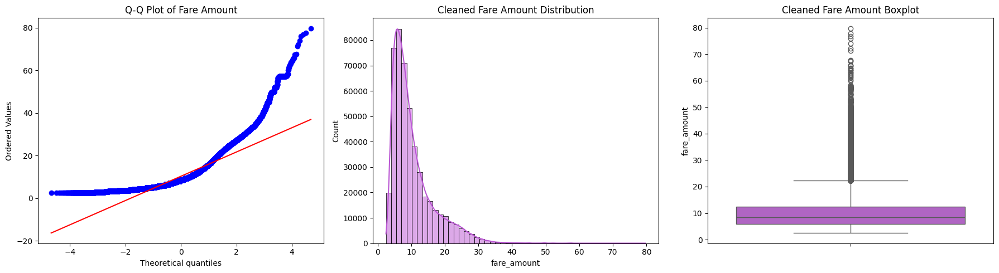


Cleaned fare stats:
Min: $2.50, Max: $79.75
Mean: $10.34, Median: $8.50


In [35]:
# Visualize the cleaned fare distribution
plt.figure(figsize=(18, 5))
plt.subplot(1, 3, 1)
stats.probplot(df_fare_cleaned[fare_col], dist="norm", plot=plt)
plt.title('Q-Q Plot of Fare Amount')
plt.subplot(1, 3, 2)
sns.histplot(df_fare_cleaned[fare_col], bins=50, kde=True, color='mediumorchid')
plt.title('Cleaned Fare Amount Distribution')
plt.subplot(1, 3, 3)
sns.boxplot(y=df_fare_cleaned[fare_col], color='mediumorchid')
plt.title('Cleaned Fare Amount Boxplot')
plt.tight_layout()
plt.show()

print(f"\nCleaned fare stats:")
print(f"Min: ${df_fare_cleaned[fare_col].min():.2f}, Max: ${df_fare_cleaned[fare_col].max():.2f}")
print(f"Mean: ${df_fare_cleaned[fare_col].mean():.2f}, Median: ${df_fare_cleaned[fare_col].median():.2f}")

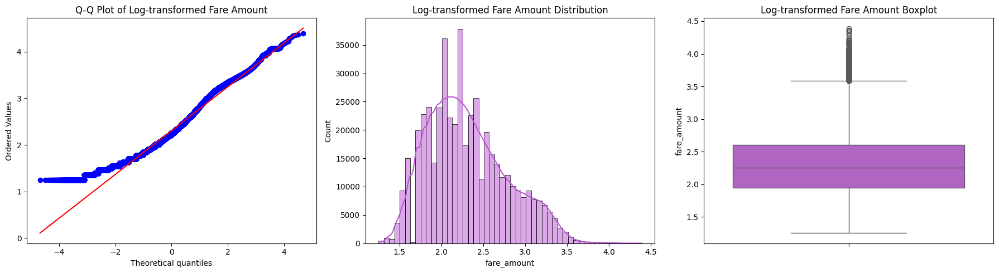

In [36]:
# log transform the fare amount
df_fare_cleaned['fare_amount'] = np.log1p(df_fare_cleaned['fare_amount'])

# Visualize the log-transformed fare distribution
plt.figure(figsize=(18, 5))
plt.subplot(1, 3, 1)
stats.probplot(df_fare_cleaned['fare_amount'], dist="norm", plot=plt)
plt.title('Q-Q Plot of Log-transformed Fare Amount')
plt.subplot(1, 3, 2)
sns.histplot(df_fare_cleaned['fare_amount'], bins=50, kde=True, color='mediumorchid')
plt.title('Log-transformed Fare Amount Distribution')
plt.subplot(1, 3, 3)
sns.boxplot(y=df_fare_cleaned['fare_amount'], color='mediumorchid')
plt.title('Log-transformed Fare Amount Boxplot')
plt.tight_layout()
plt.show()

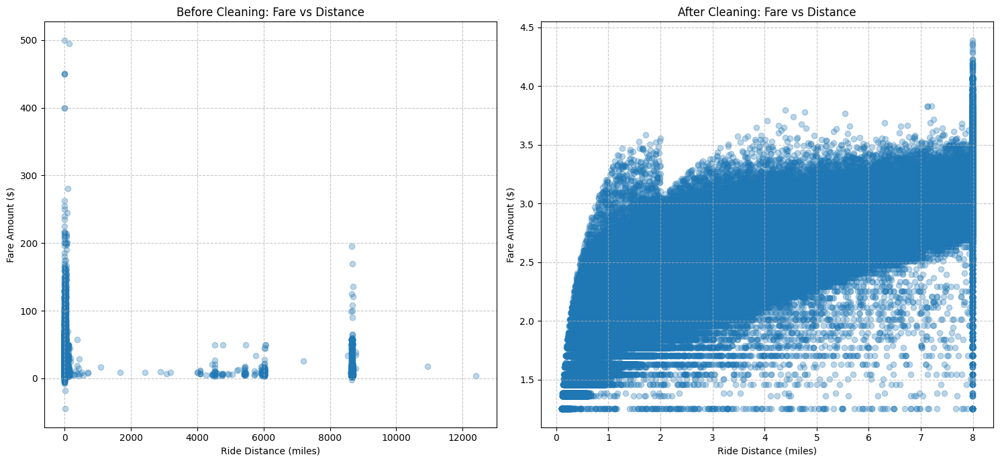

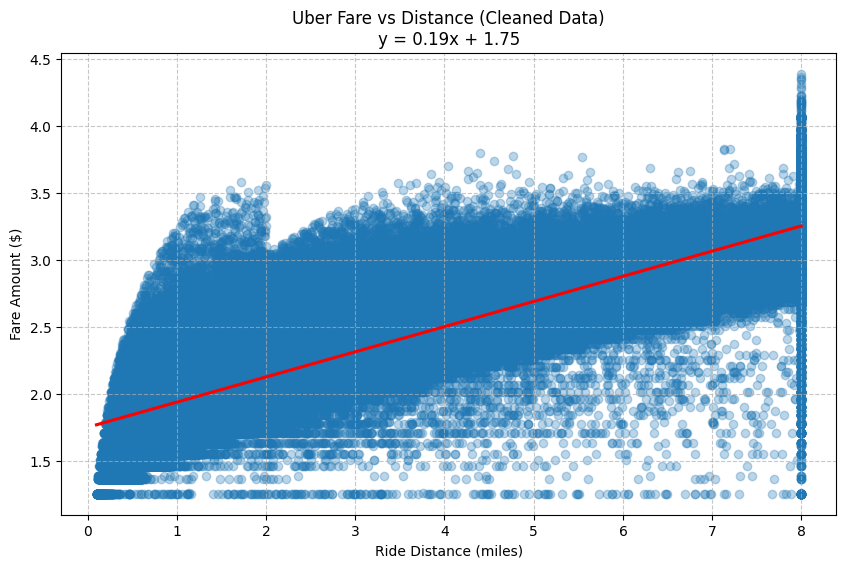


FINAL RESULTS:
--------------------------------------------------
Original data points: 499995
Final cleaned data points: 478897 (95.8%)
Original correlation: 0.0265
Cleaned correlation: 0.8737


In [37]:
# Plot the key fare vs distance relationship before and after cleaning
plt.figure(figsize=(15, 7))

plt.subplot(1, 2, 1)
plt.scatter(data_original[ride_dist_col], data_original[fare_col], alpha=0.3)
plt.title('Before Cleaning: Fare vs Distance')
plt.xlabel('Ride Distance (miles)')
plt.ylabel('Fare Amount ($)')
plt.grid(True, linestyle='--', alpha=0.7)

plt.subplot(1, 2, 2)
plt.scatter(df_fare_cleaned[ride_dist_col], df_fare_cleaned[fare_col], alpha=0.3)
plt.title('After Cleaning: Fare vs Distance')
plt.xlabel('Ride Distance (miles)')
plt.ylabel('Fare Amount ($)')
plt.grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

# Calculate regression line for cleaned data
plt.figure(figsize=(10, 6))
sns.regplot(x=ride_dist_col, y=fare_col, data=df_fare_cleaned, 
            scatter_kws={'alpha': 0.3}, line_kws={'color': 'red'})

# Add regression equation
x = df_fare_cleaned[ride_dist_col]
y = df_fare_cleaned[fare_col]
m, b = np.polyfit(x, y, 1)
plt.title(f'Uber Fare vs Distance (Cleaned Data)\ny = {m:.2f}x + {b:.2f}')
plt.xlabel('Ride Distance (miles)')
plt.ylabel('Fare Amount ($)')
plt.grid(True, linestyle='--', alpha=0.7)
plt.show()

# Print final statistics
print("\nFINAL RESULTS:")
print("-" * 50)
print(f"Original data points: {len(data_original)}")
print(f"Final cleaned data points: {len(df_fare_cleaned)} ({len(df_fare_cleaned)/len(data_original)*100:.1f}%)")
print(f"Original correlation: {data_original[ride_dist_col].corr(data_original[fare_col]):.4f}")
print(f"Cleaned correlation: {df_fare_cleaned[ride_dist_col].corr(df_fare_cleaned[fare_col]):.4f}")

# Update the DataFrame with cleaned data (inplace)
data_cleaned = df_fare_cleaned.copy()

In [38]:
data_cleaned.head()

,User ID,User Name,Driver Name,Car Condition,Weather,Traffic Condition,Ride ID,fare_amount,pickup_datetime,passenger_count,Request Hour,Request Day,Request Month,Request Day of the week,Request Year,Distance from JFK Airport,Distance from EWR Airport,Distance from LGA Airport,Distance from SOL,Distance from NYC,Ride Distance,bearing,fare_per_mile
3287,SD7md7lL,Catherine Crawford,Jamie Morrison,Bad,cloudy,Congested Traffic,2012-02-20 00:07:22.0000001,2.541602,2012-02-20 00:07:22,1,0,20,2,0,2012,42.118516,36.778774,16.887873,20.268015,12.109995,4.280777,2.238460,2.733149
39381,aJkByGh2,Mark Harris,Dr. Thomas Terrell DDS,Bad,cloudy,Congested Traffic,2014-02-10 00:29:26.0000002,2.251292,2014-02-10 00:29:26,1,0,10,2,0,2014,37.791491,29.085706,29.426577,8.488941,9.021395,2.724212,1.501659,3.120169
75530,Ja90xyqX,Whitney Rogers,Devin Arnold,Bad,cloudy,Congested Traffic,2013-09-30 00:03:00.00000044,1.704748,2013-09-30 00:03:00,2,0,30,9,0,2013,43.380033,31.807525,21.563027,15.368325,7.539566,0.729838,-2.738661,6.165751
120163,fZlD98vO,Zachary Goodman,Terri Taylor,Bad,cloudy,Congested Traffic,2012-07-23 00:03:28.0000003,2.292535,2012-07-23 00:03:28,1,0,23,7,0,2012,43.396824,37.520383,16.601963,21.888568,13.928909,2.810484,-1.498101,3.166714
145026,2WQrxyk9,Jennifer Lynch,Benjamin Hernandez,Bad,cloudy,Congested Traffic,2014-03-10 00:21:05.0000002,1.504077,2014-03-10 00:21:05,1,0,10,3,0,2014,45.297754,33.310775,20.662799,18.343101,10.879483,0.670887,-0.508156,5.216975


## Feature Engineering

##### 1. Temporal Feature Engineering

In [39]:
# Convert pickup_datetime to proper datetime if not already
data_cleaned['pickup_datetime'] = pd.to_datetime(data_cleaned['pickup_datetime'])

# Time-based features
data_cleaned['is_rush_hour'] = data_cleaned['Request Hour'].apply(
    lambda x: 1 if (6 <= x <= 10) or (16 <= x <= 19) else 0
)
data_cleaned['is_weekend'] = data_cleaned['Request Day of the week'].apply(lambda x: 1 if x >= 5 else 0)
data_cleaned['is_night'] = data_cleaned['Request Hour'].apply(lambda x: 1 if (22 <= x or x <= 5) else 0)

# Day period
def get_day_period(hour):
    if 5 <= hour <= 11:
        return 'Morning'
    elif 12 <= hour <= 16:
        return 'Afternoon'
    elif 17 <= hour <= 21:
        return 'Evening'
    else:
        return 'Night'
        
data_cleaned['day_period'] = data_cleaned['Request Hour'].apply(get_day_period)

# US Holidays
us_holidays = holidays.US(years=range(2012, 2015))
data_cleaned['is_holiday'] = data_cleaned['pickup_datetime'].dt.date.apply(lambda x: 1 if x in us_holidays else 0)

##### 2. Distance & Location Feature Engineering

In [40]:
# Nearest airport
data_cleaned['nearest_airport_dist'] = data_cleaned[['Distance from JFK Airport', 
                                                   'Distance from EWR Airport', 
                                                   'Distance from LGA Airport']].min(axis=1)

##### 3. Categorical Feature Engineering

In [41]:
# Directional analysis based on bearing
def get_cardinal_direction(bearing):
    bearing_rad = float(bearing)
    if -0.4 < bearing_rad < 0.4:
        return 'East'
    elif 0.4 <= bearing_rad < 1.2:
        return 'Northeast'
    elif 1.2 <= bearing_rad < 2.0:
        return 'North'
    elif 2.0 <= bearing_rad < 2.8:
        return 'Northwest' 
    elif bearing_rad >= 2.8 or bearing_rad <= -2.8:
        return 'West'
    elif -2.8 < bearing_rad <= -2.0:
        return 'Southwest'
    elif -2.0 < bearing_rad <= -1.2:
        return 'South'
    elif -1.2 < bearing_rad <= -0.4:
        return 'Southeast'
    else:
        return 'Unknown'

data_cleaned['cardinal_direction'] = data_cleaned['bearing'].apply(get_cardinal_direction)



In [42]:
# Discover the unique values of the columns
checked_columns = ['Car Condition', 'Weather', 'Traffic Condition', 'is_rush_hour',
                   'is_weekend', 'is_night', 'day_period', 'is_holiday', 'cardinal_direction']
for column in checked_columns:
    print(column)
    print(data_cleaned[column].unique())
    print("----------------")

Car Condition
['Bad' 'Excellent' 'Good' 'Very Good']
----------------
Weather
['cloudy' 'rainy' 'stormy' 'sunny' 'windy']
----------------
Traffic Condition
['Congested Traffic' 'Dense Traffic' 'Flow Traffic']
----------------
is_rush_hour
[0 1]
----------------
is_weekend
[0 1]
----------------
is_night
[1 0]
----------------
day_period
['Night' 'Morning' 'Afternoon' 'Evening']
----------------
is_holiday
[1 0]
----------------
cardinal_direction
['Northwest' 'North' 'Southwest' 'South' 'Southeast' 'West' 'East'
 'Northeast']
----------------


In [43]:
# Target encoding for Car Condition
car_condition_order = {'Bad': 0, 'Good': 1, 'Very Good': 2, 'Excellent': 3}
data_cleaned['Car Condition'] = data_cleaned['Car Condition'].map(car_condition_order)

# Ordinal encoding for Traffic Condition
traffic_condition_order = {'Flow Traffic': 0, 'Dense Traffic': 1, 'Congested Traffic': 2}
data_cleaned['Traffic Condition'] = data_cleaned['Traffic Condition'].map(traffic_condition_order)

# Ordinal encoding for day period
day_period_order = {'Morning': 0, 'Afternoon': 1, 'Evening': 2, 'Night': 3}
data_cleaned['day_period'] = data_cleaned['day_period'].map(day_period_order)

# One-hot encoding for Weather
weather_encoded = pd.get_dummies(data_cleaned['Weather'], prefix='weather')
data_cleaned = pd.concat([data_cleaned, weather_encoded], axis=1)

In [44]:
def cyclic_encode_direction(directions):
    # Map cardinal directions to angles (in degrees)
    direction_to_angle = {
        'North': 0,
        'Northeast': 45,
        'East': 90,
        'Southeast': 135,
        'South': 180,
        'Southwest': 225,
        'West': 270,
        'Northwest': 315,
    }
    
    # Convert to radians for sine and cosine
    angles_rad = np.array([direction_to_angle.get(direction, 0) * np.pi / 180 
                           for direction in directions])
    
    # Create sine and cosine features
    sin_direction = np.sin(angles_rad)
    cos_direction = np.cos(angles_rad)
    
    return sin_direction, cos_direction

In [45]:
sin_dir, cos_dir = cyclic_encode_direction(data_cleaned['cardinal_direction'])

# Add the new features to the dataframe
data_cleaned['direction_sin'] = sin_dir
data_cleaned['direction_cos'] = cos_dir

C:\Users\Habiba\AppData\Roaming\Python\Python313\site-packages\IPython\core\pylabtools.py:170: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


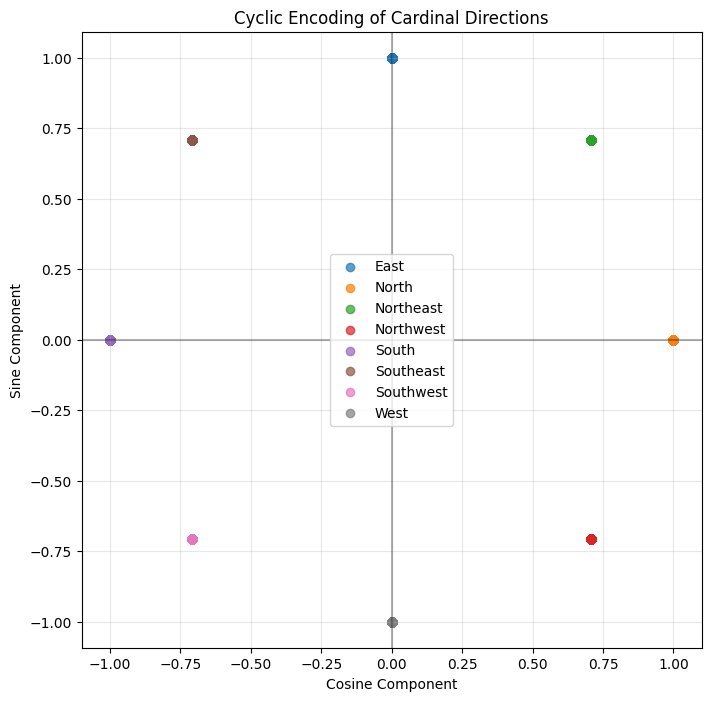

Cyclic encoding complete: replaced cardinal_direction with direction_sin and direction_cos


In [46]:
plt.figure(figsize=(8, 8))
# Create a scatter plot of the cyclic encoding
for direction in np.unique(data_cleaned['cardinal_direction']):
    mask = data_cleaned['cardinal_direction'] == direction
    plt.scatter(data_cleaned.loc[mask, 'direction_cos'], 
                data_cleaned.loc[mask, 'direction_sin'],
                label=direction, alpha=0.7)

plt.axhline(y=0, color='k', linestyle='-', alpha=0.3)
plt.axvline(x=0, color='k', linestyle='-', alpha=0.3)
plt.grid(True, alpha=0.3)
plt.legend()
plt.title('Cyclic Encoding of Cardinal Directions')
plt.xlabel('Cosine Component')
plt.ylabel('Sine Component')
plt.axis('equal')  # Ensure the plot is a circle
plt.show()

print("Cyclic encoding complete: replaced cardinal_direction with direction_sin and direction_cos")

C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\2464109024.py:18: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.histplot(np.exp(data_cleaned['fare_amount']), bins=30, kde=True, palette='magma', ax=axes[0,1])


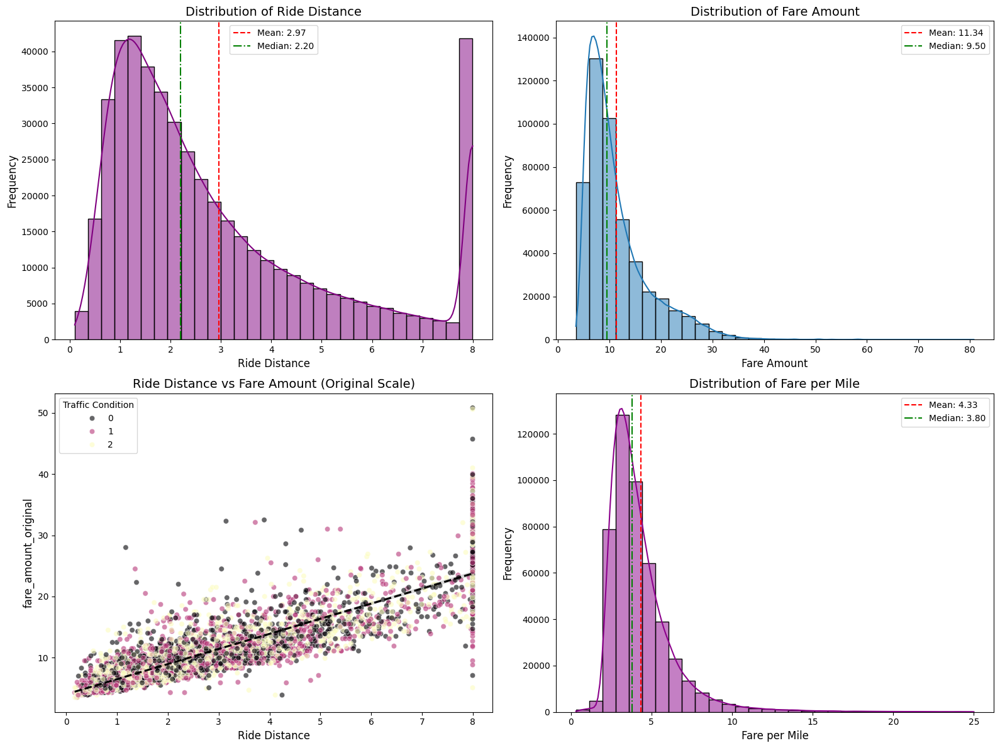

In [47]:
# Ride Distance and Fare Analysis
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# Distribution of Ride Distance (using original values)
sns.histplot(data_cleaned['Ride Distance'], bins=30, kde=True, color='purple', ax=axes[0,0])
axes[0,0].set_title('Distribution of Ride Distance', fontsize=14)
axes[0,0].set_xlabel('Ride Distance', fontsize=12)
axes[0,0].set_ylabel('Frequency', fontsize=12)

# Display actual values in the plot
mean_distance = data_cleaned['Ride Distance'].mean()
median_distance = data_cleaned['Ride Distance'].median()
axes[0,0].axvline(mean_distance, color='red', linestyle='--', label=f'Mean: {mean_distance:.2f}')
axes[0,0].axvline(median_distance, color='green', linestyle='-.', label=f'Median: {median_distance:.2f}')
axes[0,0].legend()

# Distribution of Fare Amount (using original values)
sns.histplot(np.exp(data_cleaned['fare_amount']), bins=30, kde=True, palette='magma', ax=axes[0,1])
axes[0,1].set_title('Distribution of Fare Amount', fontsize=14)
axes[0,1].set_xlabel('Fare Amount', fontsize=12)
axes[0,1].set_ylabel('Frequency', fontsize=12)

# Display actual values in the plot
mean_fare = np.exp(data_cleaned['fare_amount']).mean()
median_fare = np.exp(data_cleaned['fare_amount']).median()
axes[0,1].axvline(mean_fare, color='red', linestyle='--', label=f'Mean: {mean_fare:.2f}')
axes[0,1].axvline(median_fare, color='green', linestyle='-.', label=f'Median: {median_fare:.2f}')
axes[0,1].legend()

# Relationship between Ride Distance and Fare Amount (actual values)
# Create a sample with transformed fare_amount
sample_data = data_cleaned.sample(5000).copy()
sample_data['fare_amount_original'] = np.exp(sample_data['fare_amount'])

# Plot with transformed fare values
sns.scatterplot(data=sample_data, x='Ride Distance', y='fare_amount_original', 
                hue='Traffic Condition', palette='magma', alpha=0.6, ax=axes[1,0])
axes[1,0].set_title('Ride Distance vs Fare Amount (Original Scale)', fontsize=14)
axes[1,0].set_xlabel('Ride Distance', fontsize=12)
axes[1,0].set_ylabel('Fare Amount ($)', fontsize=12)

# Add linear regression line using the transformed values
sns.regplot(x='Ride Distance', y='fare_amount_original', data=sample_data,
            scatter=False, ax=axes[1,0], color='black', line_kws={"linestyle":"--"})

# Distribution of Fare per Mile (using original values)
sns.histplot(data_cleaned['fare_per_mile'], bins=30, kde=True, color='darkmagenta', ax=axes[1,1])
axes[1,1].set_title('Distribution of Fare per Mile', fontsize=14)
axes[1,1].set_xlabel('Fare per Mile', fontsize=12)
axes[1,1].set_ylabel('Frequency', fontsize=12)

# Display actual values in the plot
mean_fare_per_mile = data_cleaned['fare_per_mile'].mean()
median_fare_per_mile = data_cleaned['fare_per_mile'].median()
axes[1,1].axvline(mean_fare_per_mile, color='red', linestyle='--', label=f'Mean: {mean_fare_per_mile:.2f}')
axes[1,1].axvline(median_fare_per_mile, color='green', linestyle='-.', label=f'Median: {median_fare_per_mile:.2f}')
axes[1,1].legend()

plt.tight_layout()
plt.show()

C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\4187301280.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=hour_counts.index, y=hour_counts.values, palette='magma', ax=axes[0,0])
C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\4187301280.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=day_counts.index, y=day_counts.values, palette='magma', ax=axes[0,1])
C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\4187301280.py:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=month_counts.index, y=month_counts.values, palette='magma', a

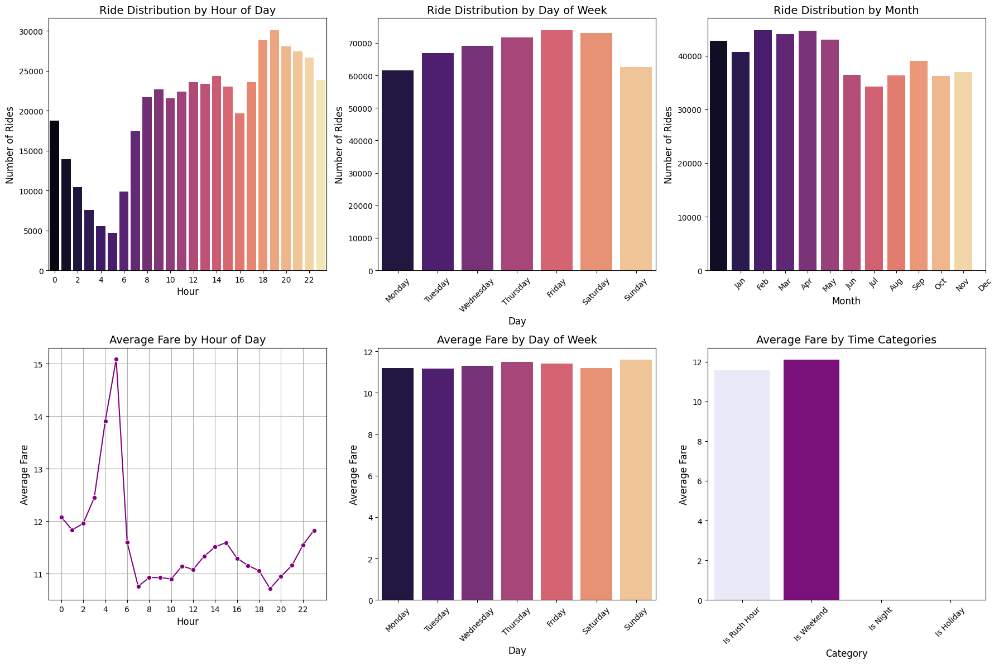

In [48]:
# Temporal Analysis - Request Patterns
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

# Hour of day distribution
hour_counts = data_cleaned['Request Hour'].value_counts().sort_index()
sns.barplot(x=hour_counts.index, y=hour_counts.values, palette='magma', ax=axes[0,0])
axes[0,0].set_title('Ride Distribution by Hour of Day', fontsize=14)
axes[0,0].set_xlabel('Hour', fontsize=12)
axes[0,0].set_ylabel('Number of Rides', fontsize=12)
axes[0,0].set_xticks(range(0, 24, 2))

# Day of week distribution
day_names = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_counts = data_cleaned['Request Day of the week'].value_counts().sort_index()
sns.barplot(x=day_counts.index, y=day_counts.values, palette='magma', ax=axes[0,1])
axes[0,1].set_title('Ride Distribution by Day of Week', fontsize=14)
axes[0,1].set_xlabel('Day', fontsize=12)
axes[0,1].set_ylabel('Number of Rides', fontsize=12)
axes[0,1].set_xticks(range(7))
axes[0,1].set_xticklabels(day_names)
axes[0,1].tick_params(axis='x', rotation=45)

# Month distribution
month_names = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']
month_counts = data_cleaned['Request Month'].value_counts().sort_index()
sns.barplot(x=month_counts.index, y=month_counts.values, palette='magma', ax=axes[0,2])
axes[0,2].set_title('Ride Distribution by Month', fontsize=14)
axes[0,2].set_xlabel('Month', fontsize=12)
axes[0,2].set_ylabel('Number of Rides', fontsize=12)
axes[0,2].set_xticks(range(1, 13))
axes[0,2].set_xticklabels(month_names)
axes[0,2].tick_params(axis='x', rotation=45)

# Average fare by hour
hourly_fares = data_cleaned.groupby('Request Hour')['fare_amount'].apply(lambda x: np.exp(x).mean())
sns.lineplot(x=hourly_fares.index, y=hourly_fares.values, marker='o', color='purple', ax=axes[1,0])
axes[1,0].set_title('Average Fare by Hour of Day', fontsize=14)
axes[1,0].set_xlabel('Hour', fontsize=12)
axes[1,0].set_ylabel('Average Fare', fontsize=12)
axes[1,0].set_xticks(range(0, 24, 2))
axes[1,0].grid(True)

# Average fare by day of week
daily_fares = data_cleaned.groupby('Request Day of the week')['fare_amount'].apply(lambda x: np.exp(x).mean())
sns.barplot(x=daily_fares.index, y=daily_fares.values, palette='magma', ax=axes[1,1])
axes[1,1].set_title('Average Fare by Day of Week', fontsize=14)
axes[1,1].set_xlabel('Day', fontsize=12)
axes[1,1].set_ylabel('Average Fare', fontsize=12)
axes[1,1].set_xticks(range(7))
axes[1,1].set_xticklabels(day_names)
axes[1,1].tick_params(axis='x', rotation=45)

# Fare trend by time flags
time_categories = ['is_rush_hour', 'is_weekend', 'is_night', 'is_holiday']
means = [data_cleaned.groupby(cat)['fare_amount'].apply(lambda x: np.exp(x).mean()) for cat in time_categories]
for i, (cat, mean_vals) in enumerate(zip(time_categories, means)):
    pos = i % 2
    sns.barplot(x=[0, 1], y=mean_vals.values, palette=['lavender', 'darkmagenta'], ax=axes[1,2])
    axes[1,2].set_title('Average Fare by Time Categories', fontsize=14)
    axes[1,2].set_xlabel('Category', fontsize=12)
    axes[1,2].set_ylabel('Average Fare', fontsize=12)
    axes[1,2].set_xticks(range(len(time_categories)))
    axes[1,2].set_xticklabels([cat.replace('_', ' ').title() for cat in time_categories])
    axes[1,2].tick_params(axis='x', rotation=45)

plt.tight_layout()
plt.show()

C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\3889142761.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=car_condition_counts.index, y=car_condition_counts.values, palette='magma', ax=axes[0,0])
C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\3889142761.py:13: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=traffic_condition_counts.index, y=traffic_condition_counts.values, palette='magma', ax=axes[0,1])
C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\3889142761.py:21: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=weather_counts.

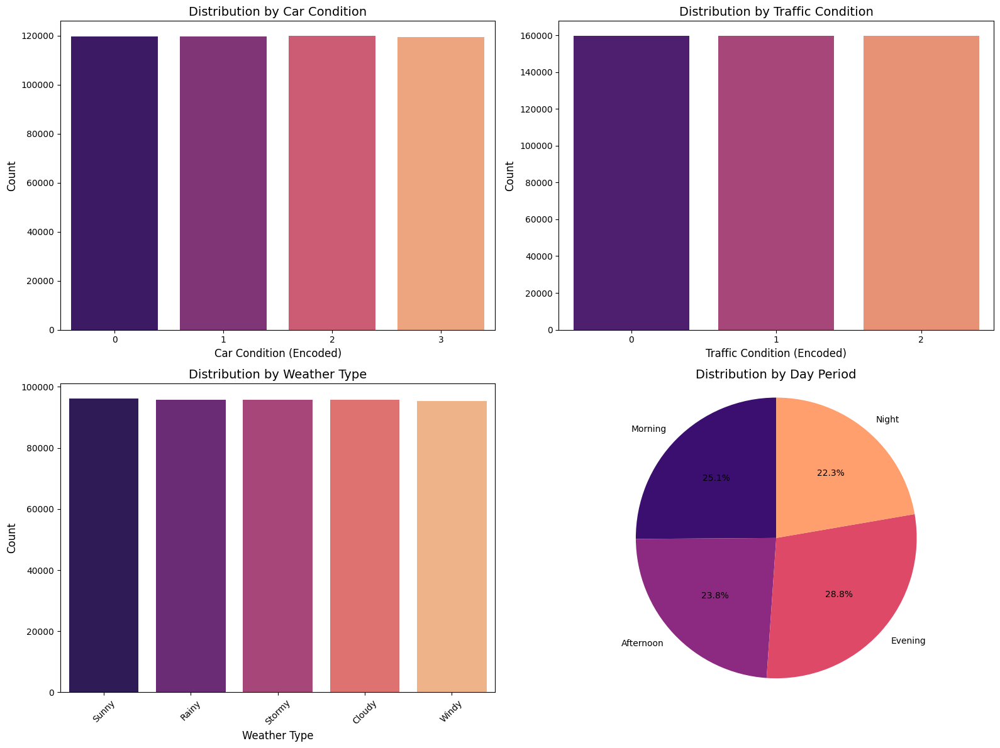

In [49]:
# Condition and Weather Analysis
fig, axes = plt.subplots(2, 2, figsize=(16, 12))

# Car Condition Analysis
car_condition_counts = data_cleaned['Car Condition'].value_counts().sort_index()
sns.barplot(x=car_condition_counts.index, y=car_condition_counts.values, palette='magma', ax=axes[0,0])
axes[0,0].set_title('Distribution by Car Condition', fontsize=14)
axes[0,0].set_xlabel('Car Condition (Encoded)', fontsize=12)
axes[0,0].set_ylabel('Count', fontsize=12)

# Traffic Condition Analysis
traffic_condition_counts = data_cleaned['Traffic Condition'].value_counts().sort_index()
sns.barplot(x=traffic_condition_counts.index, y=traffic_condition_counts.values, palette='magma', ax=axes[0,1])
axes[0,1].set_title('Distribution by Traffic Condition', fontsize=14)
axes[0,1].set_xlabel('Traffic Condition (Encoded)', fontsize=12)
axes[0,1].set_ylabel('Count', fontsize=12)

# Weather Analysis using one-hot encoded columns
weather_columns = [col for col in data_cleaned.columns if col.startswith('weather_')]
weather_counts = data_cleaned[weather_columns].sum().sort_values(ascending=False)
sns.barplot(x=weather_counts.index, y=weather_counts.values, palette='magma', ax=axes[1,0])
axes[1,0].set_title('Distribution by Weather Type', fontsize=14)
axes[1,0].set_xlabel('Weather Type', fontsize=12)
axes[1,0].set_ylabel('Count', fontsize=12)
axes[1,0].set_xticklabels([col.replace('weather_', '').capitalize() for col in weather_counts.index])
axes[1,0].tick_params(axis='x', rotation=45)

# Day Period Analysis
day_period_counts = data_cleaned['day_period'].value_counts().sort_index()
labels = ['Morning', 'Afternoon', 'Evening', 'Night']
axes[1,1].pie(day_period_counts.values, labels=labels, autopct='%1.1f%%', 
         colors=sns.color_palette("magma", 4), startangle=90)
axes[1,1].set_title('Distribution by Day Period', fontsize=14)
axes[1,1].axis('equal')

plt.tight_layout()
plt.show()

C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\2330536864.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='variable', y='value', data=airport_data, palette='magma', ax=ax1)
C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\2330536864.py:20: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax1.set_xticklabels([col.replace('Distance from ', '').replace(' Airport', '') for col in airport_cols])


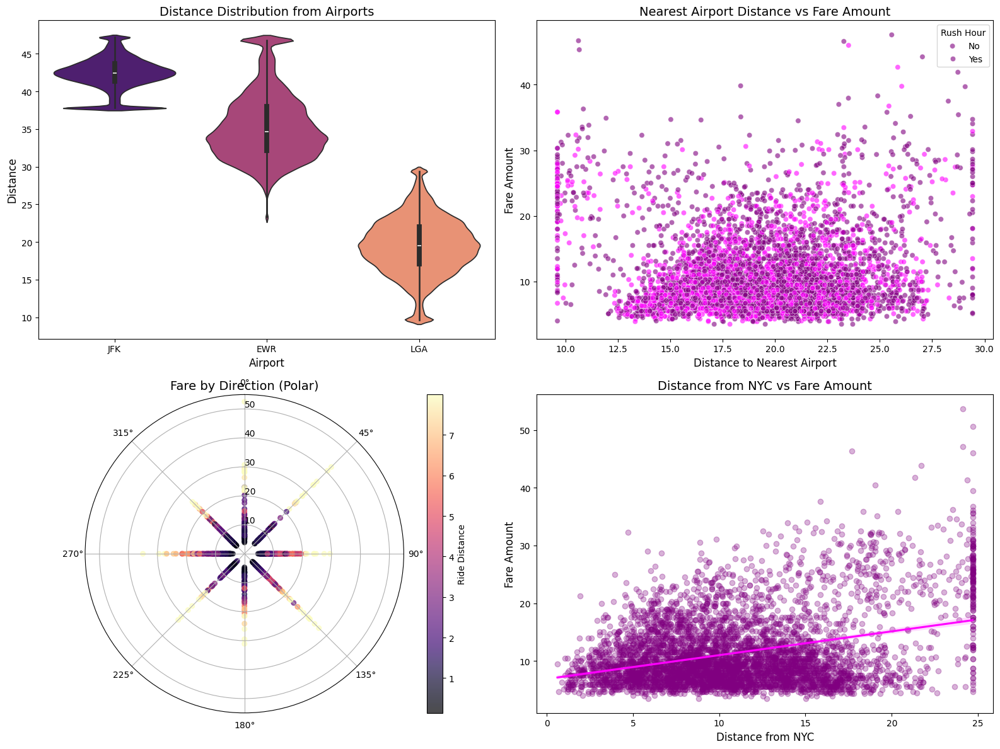

In [50]:
# Spatial Analysis
fig = plt.figure(figsize=(16, 12))
gs = fig.add_gridspec(2, 2)

# Create regular axes for 3 of the plots
ax1 = fig.add_subplot(gs[0, 0])
ax2 = fig.add_subplot(gs[0, 1])
ax4 = fig.add_subplot(gs[1, 1])

# Create a polar axes for the direction plot
ax3 = fig.add_subplot(gs[1, 0], projection='polar')

# Airport Distance Analysis
airport_cols = ['Distance from JFK Airport', 'Distance from EWR Airport', 'Distance from LGA Airport']
airport_data = data_cleaned[airport_cols].melt()
sns.violinplot(x='variable', y='value', data=airport_data, palette='magma', ax=ax1)
ax1.set_title('Distance Distribution from Airports', fontsize=14)
ax1.set_xlabel('Airport', fontsize=12)
ax1.set_ylabel('Distance', fontsize=12)
ax1.set_xticklabels([col.replace('Distance from ', '').replace(' Airport', '') for col in airport_cols])

# Relationship between nearest airport distance and fare
airport_sample = data_cleaned.sample(5000).copy()
airport_sample['fare_amount_original'] = np.exp(airport_sample['fare_amount'])

sns.scatterplot(data=airport_sample, x='nearest_airport_dist', y='fare_amount_original',
                hue='is_rush_hour', palette=['purple', 'magenta'], alpha=0.6, ax=ax2)
ax2.set_title('Nearest Airport Distance vs Fare Amount', fontsize=14)
ax2.set_xlabel('Distance to Nearest Airport', fontsize=12) 
ax2.set_ylabel('Fare Amount', fontsize=12)
ax2.legend(title='Rush Hour', labels=['No', 'Yes'])

# Direction Analysis using sin/cos
# Create a polar scatter plot using direction_sin and direction_cos
sample = data_cleaned.sample(1000)
thetas = np.arctan2(sample['direction_sin'], sample['direction_cos'])
fares = np.exp(sample['fare_amount'])
scatter = ax3.scatter(thetas, fares, c=sample['Ride Distance'], 
                     cmap='magma', alpha=0.7, s=30)
ax3.set_title('Fare by Direction (Polar)', fontsize=14)
ax3.set_theta_zero_location("N")
ax3.set_theta_direction(-1)
ax3.set_rlabel_position(0)
plt.colorbar(scatter, ax=ax3, label='Ride Distance')

# Fare patterns by distance from NYC
nyc_sample = data_cleaned.sample(5000).copy()
nyc_sample['fare_amount_original'] = np.exp(nyc_sample['fare_amount'])  # Apply exponential transformation
sns.regplot(x='Distance from NYC', y='fare_amount_original',  # Use transformed values 
            data=nyc_sample, 
            scatter_kws={'alpha':0.3, 'color':'purple'}, 
            line_kws={'color':'magenta'}, ax=ax4)
ax4.set_title('Distance from NYC vs Fare Amount', fontsize=14)
ax4.set_xlabel('Distance from NYC', fontsize=12)
ax4.set_ylabel('Fare Amount', fontsize=12)

plt.tight_layout()
plt.show()

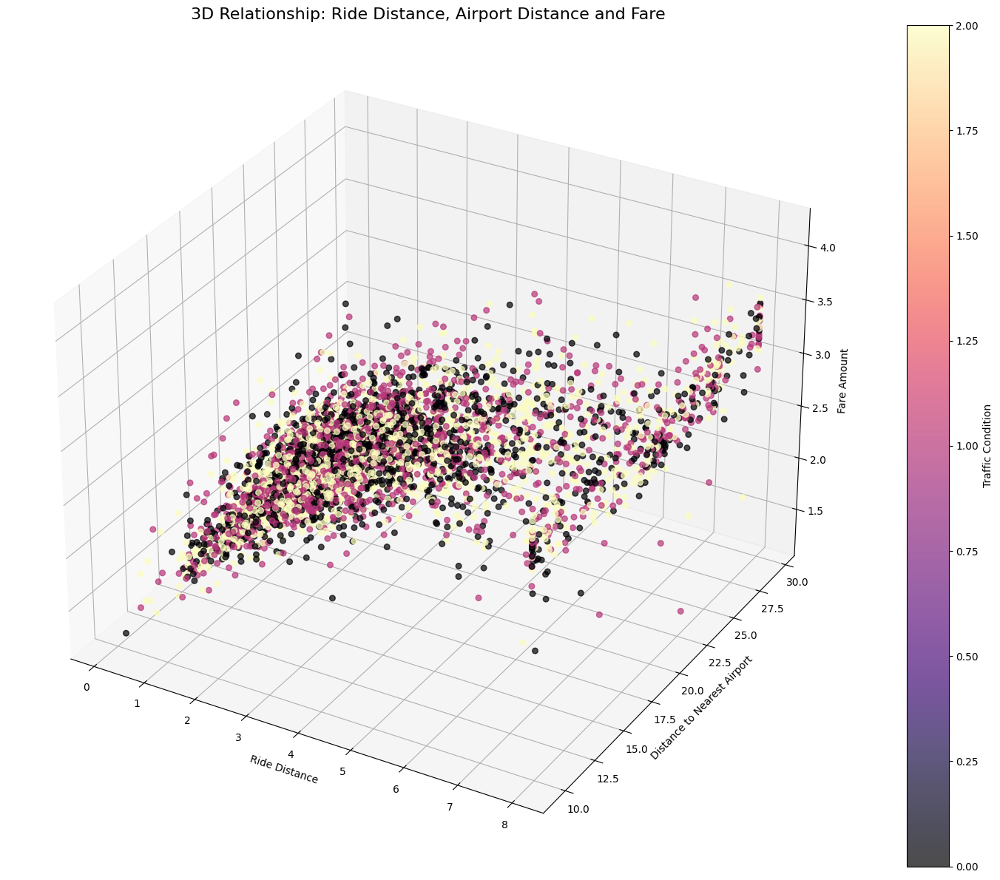

In [51]:
# Create 3D plot for spatial relationships
fig = plt.figure(figsize=(16, 12))
ax = fig.add_subplot(111, projection='3d')

# Sample data
sample = data_cleaned.sample(5000)

# Create scatter plot
scatter = ax.scatter(sample['Ride Distance'], 
                    sample['nearest_airport_dist'], 
                    sample['fare_amount'],
                    c=sample['Traffic Condition'],
                    cmap='magma',
                    s=30,
                    alpha=0.7)

ax.set_xlabel('Ride Distance')
ax.set_ylabel('Distance to Nearest Airport')
ax.set_zlabel('Fare Amount')
ax.set_title('3D Relationship: Ride Distance, Airport Distance and Fare', fontsize=16)

# Add a color bar
cbar = plt.colorbar(scatter)
cbar.set_label('Traffic Condition')

plt.tight_layout()
plt.show()

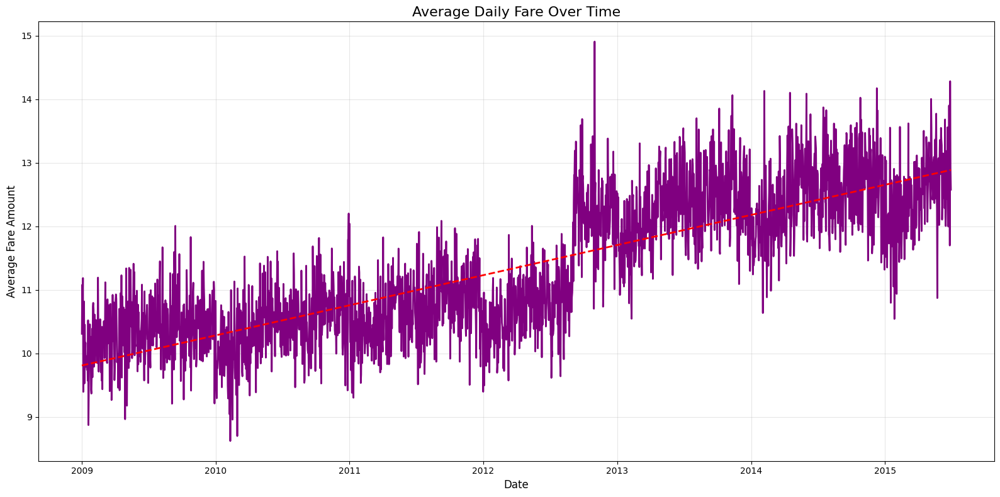

In [52]:
# Time series analysis of fares
plt.figure(figsize=(16, 8))

# Convert pickup_datetime to datetime if needed
data_cleaned['pickup_datetime'] = pd.to_datetime(data_cleaned['pickup_datetime'])

# Group by date and calculate mean fare
daily_fares = data_cleaned.groupby(data_cleaned['pickup_datetime'].dt.date)['fare_amount'].apply(lambda x: np.exp(x).mean())
daily_fares = daily_fares.sort_index()

# Plot the time series with trend line
sns.lineplot(x=daily_fares.index, y=daily_fares.values, color='purple', linewidth=2)
plt.title('Average Daily Fare Over Time', fontsize=16)
plt.xlabel('Date', fontsize=12)
plt.ylabel('Average Fare Amount', fontsize=12)
plt.grid(True, alpha=0.3)

# Add trend line
z = np.polyfit(range(len(daily_fares)), daily_fares.values, 1)
p = np.poly1d(z)
plt.plot(daily_fares.index, p(range(len(daily_fares))), "r--", linewidth=2)

plt.tight_layout()
plt.show()

In [53]:
data_cleaned.drop(['User ID', 'User Name', 'Driver Name', 'Ride ID', 'bearing', 'Weather', 'cardinal_direction'], axis=1, inplace=True)

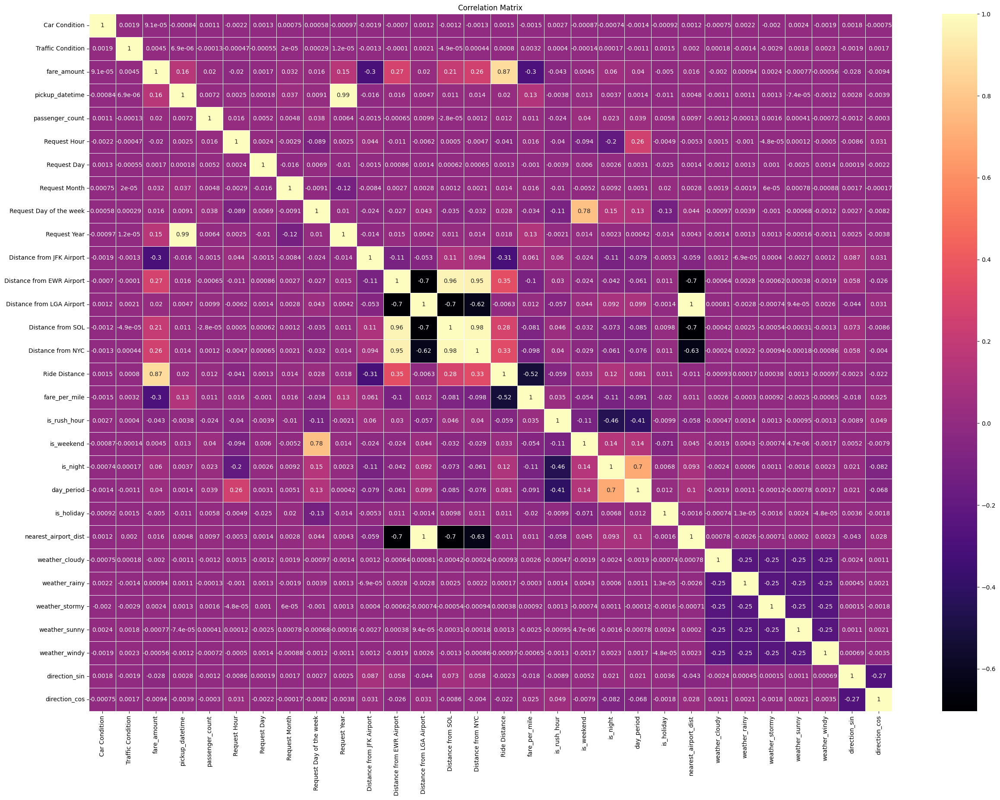

In [54]:
# Correlation matrix
plt.figure(figsize=(30, 21))
correlation_matrix = data_cleaned.corr()
sns.heatmap(correlation_matrix, annot=True, cmap='magma', linewidths=0.5)
plt.title('Correlation Matrix')
plt.show()

In [55]:
correlation_matrix

,Car Condition,Traffic Condition,fare_amount,pickup_datetime,passenger_count,Request Hour,Request Day,Request Month,Request Day of the week,Request Year,Distance from JFK Airport,Distance from EWR Airport,Distance from LGA Airport,Distance from SOL,Distance from NYC,Ride Distance,fare_per_mile,is_rush_hour,is_weekend,is_night,day_period,is_holiday,nearest_airport_dist,weather_cloudy,weather_rainy,weather_stormy,weather_sunny,weather_windy,direction_sin,direction_cos
Car Condition,1.000000,0.001903,0.000091,-0.000843,0.001122,-0.002224,0.001283,0.000747,0.000578,-0.000971,-0.001864,-0.000697,0.001189,-0.001203,-0.001304,0.001483,-0.001450,0.002668,-0.000872,-0.000743,-0.001365,-0.000919,0.001211,-0.000746,0.002209,-0.001965,0.002381,-0.001887,0.001827,-0.000747
Traffic Condition,0.001903,1.000000,0.004525,0.000007,-0.000133,-0.000468,-0.000547,0.000020,0.000287,0.000012,-0.001310,-0.000100,0.002136,-0.000049,0.000439,0.000802,0.003176,0.000399,-0.000139,0.000174,-0.001117,0.001483,0.001988,0.000175,-0.001397,-0.002913,0.001846,0.002289,-0.001897,0.001735
fare_amount,0.000091,0.004525,1.000000,0.155996,0.020356,-0.020195,0.001701,0.032361,0.015792,0.150019,-0.302924,0.271322,0.019949,0.208255,0.257368,0.873662,-0.295692,-0.043460,0.004534,0.059835,0.039589,-0.004952,0.015837,-0.001986,0.000943,0.002367,-0.000767,-0.000557,-0.027930,-0.009386
pickup_datetime,-0.000843,0.000007,0.155996,1.000000,0.007244,0.002459,0.000185,0.036553,0.009095,0.988070,-0.015585,0.015610,0.004710,0.011210,0.014039,0.020062,0.130467,-0.003780,0.012972,0.003713,0.001351,-0.010844,0.004770,-0.001119,0.001073,0.001302,-0.000074,-0.001184,0.002766,-0.003882
passenger_count,0.001122,-0.000133,0.020356,0.007244,1.000000,0.015999,0.005174,0.004801,0.037629,0.006385,-0.001535,-0.000652,0.009882,-0.000028,0.001228,0.011699,0.010550,-0.023746,0.039955,0.023299,0.038775,0.005841,0.009672,-0.001150,-0.000126,0.001582,0.000408,-0.000716,-0.001159,-0.000299
Request Hour,-0.002224,-0.000468,-0.020195,0.002459,0.015999,1.000000,0.002394,-0.002901,-0.088535,0.002459,0.044394,-0.011107,-0.006161,0.000497,-0.004669,-0.041097,0.016171,-0.039726,-0.093596,-0.203176,0.261094,-0.004944,-0.005285,0.001464,-0.001033,-0.000048,0.000120,-0.000504,-0.008576,0.031433
Request Day,0.001283,-0.000547,0.001701,0.000185,0.005174,0.002394,1.000000,-0.016103,0.006860,-0.010070,-0.001541,0.000863,0.001387,0.000618,0.000654,0.001323,-0.001036,-0.003949,0.006019,0.002586,0.003051,-0.024705,0.001354,-0.001207,0.001316,0.001035,-0.002493,0.001356,0.000193,-0.002223
Request Month,0.000747,0.000020,0.032361,0.036553,0.004801,-0.002901,-0.016103,1.000000,-0.009110,-0.117257,-0.008410,0.002701,0.002849,0.001221,0.002105,0.014384,0.015512,-0.010174,-0.005158,0.009166,0.005089,0.019884,0.002815,0.001886,-0.001853,0.000060,0.000781,-0.000876,0.001701,-0.000173
Request Day of the week,0.000578,0.000287,0.015792,0.009095,0.037629,-0.088535,0.006860,-0.009110,1.000000,0.010377,-0.023731,-0.026648,0.043232,-0.034837,-0.032052,0.028271,-0.033683,-0.106303,0.780149,0.146000,0.133293,-0.125171,0.043836,-0.000968,0.003881,-0.001030,-0.000681,-0.001205,0.002741,-0.008185
Request Year,-0.000971,0.000012,0.150019,0.988070,0.006385,0.002459,-0.010070,-0.117257,0.010377,1.000000,-0.014194,0.015092,0.004228,0.010946,0.013623,0.017735,0.127240,-0.002126,0.013634,0.002330,0.000415,-0.013597,0.004293,-0.001387,0.001332,0.001270,-0.000160,-0.001058,0.002488,-0.003816


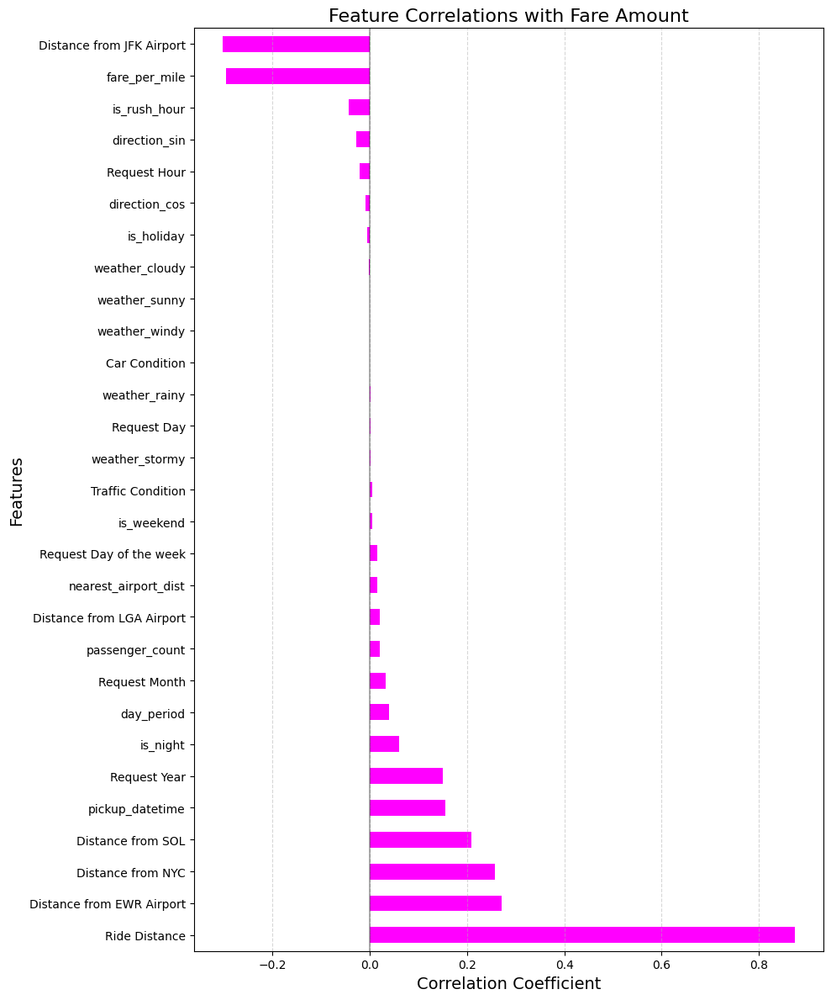

In [56]:
plt.figure(figsize=(10, 12))
correlation_with_fare = data_cleaned.corr()['fare_amount'].sort_values(ascending=False)
correlation_with_fare.drop('fare_amount').plot(kind='barh', color='magenta')
plt.title('Feature Correlations with Fare Amount', fontsize=16)
plt.xlabel('Correlation Coefficient', fontsize=14)
plt.ylabel('Features', fontsize=14)
plt.axvline(x=0, color='k', linestyle='-', alpha=0.3)
plt.grid(axis='x', linestyle='--', alpha=0.5)
plt.tight_layout()
plt.show()

In [57]:
# Select only numerical features for VIF calculation
numerical_features = data_cleaned.select_dtypes(include=['int64', 'float64']).columns.tolist()
if 'fare_amount' in numerical_features:
    numerical_features.remove('fare_amount')

# Calculate VIF for each feature
vif_data = pd.DataFrame()
vif_data["Feature"] = numerical_features
vif_data["VIF"] = [variance_inflation_factor(data_cleaned[numerical_features].fillna(0).values, i) 
                  for i in range(len(numerical_features))]

# Sort by VIF value
vif_data = vif_data.sort_values('VIF', ascending=False)

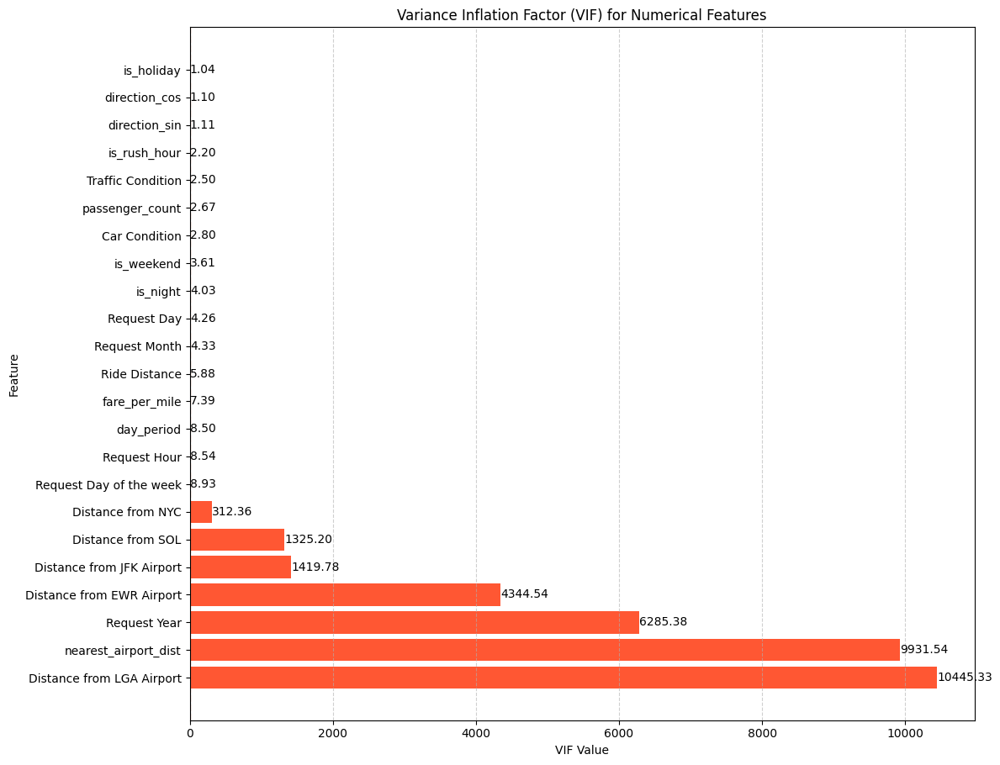

In [58]:
# Create VIF bar plot
plt.figure(figsize=(12, len(numerical_features)*0.4))  # Adjust height based on feature count

# Create color mapping based on VIF thresholds
colors = ['#FF5733' if x > 10 else '#FFC300' if x > 5 else '#33FF57' for x in vif_data['VIF']]

# Create horizontal bar chart
bars = plt.barh(vif_data['Feature'], vif_data['VIF'], color=colors)
plt.xlabel('VIF Value')
plt.ylabel('Feature')
plt.title('Variance Inflation Factor (VIF) for Numerical Features')
plt.grid(axis='x', linestyle='--', alpha=0.6)

# Add threshold lines
plt.axvline(x=5, color='orange', linestyle='--', alpha=0.7, label='VIF=5')
plt.axvline(x=10, color='red', linestyle='--', alpha=0.7, label='VIF=10')

# Add VIF values as text at the end of each bar
for i, (value, feature) in enumerate(zip(vif_data['VIF'], vif_data['Feature'])):
    plt.text(value + 0.1, i, f'{value:.2f}', va='center')

plt.tight_layout()
plt.show()

In [59]:
data_cleaned.drop(['Distance from LGA Airport', 'nearest_airport_dist', 'Distance from EWR Airport',
                   'Distance from JFK Airport', 'Distance from SOL', 'Distance from NYC',
                   'Request Year', 'fare_per_mile', 'pickup_datetime', 'passenger_count',
                   'Request Month', 'Request Day', 'day_period', 'direction_sin', 'direction_cos'], axis=1, inplace=True)

In [60]:
# Print data shape after dropping
print(f"Data shape after dropping features: {data_cleaned.shape}")

Data shape after dropping features: (478897, 15)


In [61]:
# Verify reduced multicollinearity by recalculating VIF
numerical_features_after = data_cleaned.select_dtypes(include=['int64', 'float64']).columns.tolist()
if 'fare_amount' in numerical_features_after:
    numerical_features_after.remove('fare_amount')

# Calculate new VIF values
print("\nRecalculating VIF after feature removal...")
vif_data_after = pd.DataFrame()
vif_data_after["Feature"] = numerical_features_after
vif_data_after["VIF"] = [variance_inflation_factor(data_cleaned[numerical_features_after].fillna(0).values, i) 
                        for i in range(len(numerical_features_after))]

# Sort by VIF value
vif_data_after = vif_data_after.sort_values('VIF', ascending=False)


Recalculating VIF after feature removal...


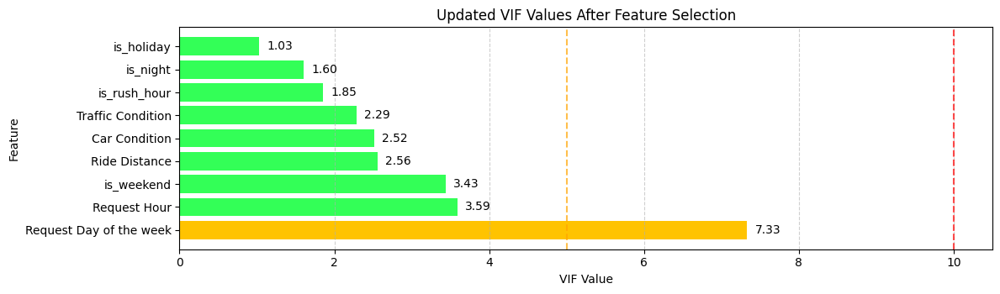

In [62]:
# Create a bar plot of the updated VIF values
plt.figure(figsize=(12, len(numerical_features_after)*0.4))
colors = ['#FF5733' if x > 10 else '#FFC300' if x > 5 else '#33FF57' for x in vif_data_after['VIF']]
bars = plt.barh(vif_data_after['Feature'], vif_data_after['VIF'], color=colors)
plt.xlabel('VIF Value')
plt.ylabel('Feature')
plt.title('Updated VIF Values After Feature Selection')
plt.grid(axis='x', linestyle='--', alpha=0.6)
plt.axvline(x=5, color='orange', linestyle='--', alpha=0.7)
plt.axvline(x=10, color='red', linestyle='--', alpha=0.7)
for i, (value, feature) in enumerate(zip(vif_data_after['VIF'], vif_data_after['Feature'])):
    plt.text(value + 0.1, i, f'{value:.2f}', va='center')
plt.tight_layout()
plt.show()

In [63]:
data_cleaned.head()

,Car Condition,Traffic Condition,fare_amount,Request Hour,Request Day of the week,Ride Distance,is_rush_hour,is_weekend,is_night,is_holiday,weather_cloudy,weather_rainy,weather_stormy,weather_sunny,weather_windy
3287,0,2,2.541602,0,0,4.280777,0,0,1,1,True,False,False,False,False
39381,0,2,2.251292,0,0,2.724212,0,0,1,0,True,False,False,False,False
75530,0,2,1.704748,0,0,0.729838,0,0,1,0,True,False,False,False,False
120163,0,2,2.292535,0,0,2.810484,0,0,1,0,True,False,False,False,False
145026,0,2,1.504077,0,0,0.670887,0,0,1,0,True,False,False,False,False


In [64]:
# Define target variable
target_variable = 'fare_amount'
X = data_cleaned.drop(columns=[target_variable])
y = data_cleaned[target_variable]

# Create train-test split
X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42, shuffle=True
)

print(f"Training set: {X_train.shape[0]} samples ({X_train.shape[0]/len(data_cleaned)*100:.1f}%)")
print(f"Test set: {X_test.shape[0]} samples ({X_test.shape[0]/len(data_cleaned)*100:.1f}%)")

Training set: 383117 samples (80.0%)
Test set: 95780 samples (20.0%)


In [65]:
# Create simple numerical preprocessing pipeline
preprocessor = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

In [66]:
# Fit on training data only - but convert to numpy array first
numerical_features = X_train.select_dtypes(include=['int64', 'float64', 'bool']).columns.tolist()
X_train_np = X_train[numerical_features].to_numpy()
X_test_np = X_test[numerical_features].to_numpy()

X_train_scaled = preprocessor.fit_transform(X_train_np)
X_test_scaled = preprocessor.transform(X_test_np)

print(f"Processed training set shape: {X_train_scaled.shape}")
print(f"Processed testing set shape: {X_test_scaled.shape}")

Processed training set shape: (383117, 14)
Processed testing set shape: (95780, 14)


##### Random Forest

In [67]:
rf_model = RandomForestRegressor(n_estimators=200, max_depth=20, min_samples_split=5, 
                              min_samples_leaf=1, random_state=42)

In [68]:
cv_rmse_scores = np.sqrt(-cross_val_score(rf_model, X_train_scaled, y_train, 
                                         cv=5, scoring='neg_mean_squared_error'))

In [69]:
rf_model.fit(X_train_scaled, y_train)

RandomForestRegressor(max_depth=20, min_samples_split=5, n_estimators=200,
                      random_state=42)

In [70]:
y_train_pred = rf_model.predict(X_train_scaled)
y_test_pred = rf_model.predict(X_test_scaled)

In [71]:
# Training metrics
y_train_orig = np.expm1(y_train)
y_train_pred_orig = np.expm1(y_train_pred)
train_rmse = np.sqrt(mean_squared_error(y_train_orig, y_train_pred_orig))
train_mae = mean_absolute_error(y_train_orig, y_train_pred_orig)
train_r2 = r2_score(y_train_orig, y_train_pred_orig)
train_mape = np.mean(np.abs((y_train_orig - y_train_pred_orig) / y_train_orig)) * 100

# Testing metrics
y_test_orig = np.expm1(y_test)
y_test_pred_orig = np.expm1(y_test_pred)
test_rmse_rf = np.sqrt(mean_squared_error(y_test_orig, y_test_pred_orig))
test_mae_rf = mean_absolute_error(y_test_orig, y_test_pred_orig)
test_r2_rf = r2_score(y_test_orig, y_test_pred_orig)
test_mape_rf = np.mean(np.abs((y_test_orig - y_test_pred_orig) / y_test_orig)) * 100

In [72]:
print("\n===== RANDOM FOREST MODEL EVALUATION =====")
print(f"Cross-validation RMSE scores: {cv_rmse_scores}")
print(f"Mean CV RMSE: ${cv_rmse_scores.mean():.2f} (±{cv_rmse_scores.std():.2f})")
print("\nTraining Metrics:")
print(f"RMSE: ${train_rmse:.2f}")
print(f"MAE: ${train_mae:.2f}")
print(f"R²: {train_r2:.4f}")
print(f"MAPE: {train_mape:.2f}%")
print("\nTest Metrics:")
print(f"RMSE: ${test_rmse_rf:.2f}")
print(f"MAE: ${test_mae_rf:.2f}")
print(f"R²: {test_r2_rf:.4f}")
print(f"MAPE: {test_mape_rf:.2f}%")


===== RANDOM FOREST MODEL EVALUATION =====
Cross-validation RMSE scores: [0.21479677 0.21729651 0.21306536 0.2153613  0.21549026]
Mean CV RMSE: $0.22 (±0.00)

Training Metrics:
RMSE: $2.04
MAE: $1.28
R²: 0.8920
MAPE: 12.82%

Test Metrics:
RMSE: $2.78
MAE: $1.80
R²: 0.7981
MAPE: 18.37%


In [73]:
# After training your Random Forest model
import pickle

# Save with explicit protocol version
with open('random_forest_model.pkl', 'wb') as f:
    pickle.dump(rf_model, f, protocol=4)  # Use protocol 4 for better compatibility

# Save the preprocessor
with open('preprocessor.pkl', 'wb') as file:
    pickle.dump(preprocessor, file)

In [74]:
# Add this to a temporary script or run in a Python shell
import os

model_path = 'D:\Cellula\Sixth_Task_Habiba_Mowafy\ML_Deployment\PocketPilot\ml_models\\random_forest_model.pkl'

# Check file size
print(f"File size: {os.path.getsize(model_path)} bytes")

# Try to read the first few bytes to check format
with open(model_path, 'rb') as f:
    header = f.read(10)
    print(f"First few bytes: {header}")

File size: 1411977403 bytes
First few bytes: b'\x80\x04\x95\x82\x05\x00\x00\x00\x00\x00'


<>:4: SyntaxWarning: invalid escape sequence '\C'
<>:4: SyntaxWarning: invalid escape sequence '\C'
C:\Users\Habiba\AppData\Local\Temp\ipykernel_592\1877565025.py:4: SyntaxWarning: invalid escape sequence '\C'
  model_path = 'D:\Cellula\Sixth_Task_Habiba_Mowafy\ML_Deployment\PocketPilot\ml_models\\random_forest_model.pkl'
